Food diveristy in select European cities
===
An aspiring data scientist's foray into theories of culture
---
----

### A. Gutmanas
#### Cambridge, 1 March 2020

-------

## Part 1
### Getting geolocation data

In [1]:
# Uncomment each line as needed
#!pip install thenmap
#!pip install folium
#!pip install shapely

In [2]:
RADIUS = 500

In [3]:
import pandas as pd
import requests
import folium
from shapely.geometry import shape, Point
import math
import json
from thenmap import Thenmap
import time

### 1A: London
Surprisingly, London open data is not easily discoverable. Luckily, AirBnB offers a rich selection of data for major cities, including geospatial data of boroughs and neighbourhoods. The data is distributed under the CC0 license - i.e., public domain. I will use this source for London and later for Stockholm (1B). Full list is available from http://insideairbnb.com/get-the-data.html

In [4]:
# get London boroughs
airbnb_london_url = "http://data.insideairbnb.com/united-kingdom/england/london/2019-11-05/visualisations/neighbourhoods.geojson"
london_boroughs_geojson = requests.get(airbnb_london_url).json()

In [5]:
london_boroughs_geojson['features'][0]['properties']

{'neighbourhood': 'Kingston upon Thames', 'neighbourhood_group': None}

In [6]:
print(f"AirBnB shows {len(london_boroughs_geojson['features'])} boroughs in London")

AirBnB shows 33 boroughs in London


33 boroughs with multimillion population is not enough granularity to do a proper analysis of which restaurants are close to each other. I explored alternatives such as postal code areas, but they are not too robust. Some datasets are not free, others are incomplete, or come in different formats that would require some effort to understand and parse. Ultimately, I need a set of points, spread over the area I want to study. Hence, I will go by a "brute force" approach and will cover the 33 boroughs of Greater London in hexagons of 2km in cross-section. These hexagons approximate a circle with a 1km radius. 


To do this, I need values for how long a degree is in meters at different latitudes, which is available from http://www.csgnetwork.com/degreelenllavcalc.html

A few utility functions will be needed for each city

In [7]:
def get_polygons(geojson_obj, borough_key="neighbourhood"):
    # Create shapely "shapes" for each borough to later position the hexagons     
    polygons = []
    for borough in geojson_obj["features"]:
        polygons.append(
            {
                "Borough": borough["properties"][borough_key],
                "shape": shape(borough["geometry"])
            }
        )
    return polygons

In [8]:
london_polygons = get_polygons(london_boroughs_geojson)

In [9]:
def get_city_box(polygons):
    # find the bounding box for all of the boroughs   
    min_lng = min([x["shape"].bounds[0] for x in polygons])
    min_lat = min([x["shape"].bounds[1] for x in polygons])
    max_lng = max([x["shape"].bounds[2] for x in polygons])
    max_lat = max([x["shape"].bounds[3] for x in polygons])
    
    return min_lng, min_lat, max_lng, max_lat    

In [10]:
def get_centre(bounding_box):
    # get an approximate centre of the city to later use in centering maps
    min_lng, min_lat, max_lng, max_lat = bounding_box
    return 0.5*(max_lat + min_lat), 0.5*(max_lng + min_lng)

The function below will be re-used for other cities, so it makes sense to define it here once

In [11]:
def get_hexagons(polygons, lat1deg, lng1deg, size=RADIUS*2):
    # Main function to calculate the centres for the hexagons overlaying the whole city
    min_lng, min_lat, max_lng, max_lat = get_city_box(polygons)
    
    delta1km_lat = size / lat1deg
    delta1km_lng = size / lng1deg
    print(f"1 km change in latitude is {delta1km_lat} degrees")
    print(f"1 km change in longitude is {delta1km_lng} degrees")
    
    # To iterate over hexagons, some secondary school trigonometry is needed 
    # I will need to define increments in degrees for latitude and longitude   
    # for longitude, the hexagonal tiles will form neat rows, touching via their edges, 
    # so my increment is actually delta * cos(30 deg)
    inc_lng = delta1km_lng*0.5*math.sqrt(3)
    # each row will be shifted by half a tile with respect to the one above it,
    # so the increment between rows is 3/4 of the delta defined above
    inc_lat = delta1km_lat*0.75

    # it is easier to iterate over integers, so calculate how many rows and how many tiles in each row
    max_tiles_lat = math.ceil((max_lat - min_lat)/inc_lat)
    max_tiles_lng = math.ceil((max_lng - min_lng)/inc_lng) + 1 
    # The +1 above is to account for shifted odd rows by half a tile
    
    tiles = {
        "Borough": [],
        "Latitude": [],
        "Longitude": []
    }

    for lat_index in range(max_tiles_lat):
        lat = min_lat + lat_index*inc_lat
        if lat_index % 2 == 0:
            shift_lng = 0 # even rows
        else:
            shift_lng = -0.5 # odd rows need to shift by half a tile
        for lng_index in range(max_tiles_lng):
            lng = min_lng + (shift_lng + lng_index)*inc_lng
            point = Point(lng, lat)
            for polygon in polygons:
                if polygon["shape"].contains(point):
                    tiles["Borough"].append(polygon["Borough"])
                    tiles["Latitude"].append(lat)
                    tiles["Longitude"].append(lng)
                    break
    return pd.DataFrame(tiles)


In [12]:
centre_lat_lon, centre_lng_lon = get_centre(get_city_box(london_polygons))
print(f"Approximate coordinates for city centre. Latitude: {centre_lat_lon}, Longitude: {centre_lng_lon}")

Approximate coordinates for city centre. Latitude: 51.489317, Longitude: -0.08817950000000002


In [13]:
# Using 51.5 degrees latitude, I get the following lengths of a degree in each direction
# http://www.csgnetwork.com/degreelenllavcalc.html
# length of 1 degree latitude (more or less invariable) (in m)
lat1deg_lon = 111257.79456880149
# length of 1 degree longitude at 51.5 degrees latitude (in m)
lng1deg_lon = 69440.48979357751

In [14]:
london_df = get_hexagons(london_polygons, lat1deg_lon, lng1deg_lon)
london_df.head()


1 km change in latitude is 0.008988134304438355 degrees
1 km change in longitude is 0.014400820083105018 degrees


,Borough,Latitude,Longitude
0,Croydon,51.293501,-0.129995
1,Croydon,51.293501,-0.117524
2,Bromley,51.293501,0.019663
3,Bromley,51.293501,0.044606
4,Bromley,51.293501,0.057077


In [15]:
london_df.shape

(2417, 3)

In [16]:
london_map = folium.Map(
    location=[centre_lat_lon, centre_lng_lon], 
    zoom_start=10, 
    tiles='cartodbpositron'
)

for borough in london_boroughs_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson'
    ).add_to(london_map)

for lat, lng in zip(london_df["Latitude"], london_df["Longitude"]):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=None,
        color='#d8b365',
        fill=True,
        fill_color='#d8b365',
        fill_opacity=0.3,
        parse_html=False
    ).add_to(london_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Greater London boroughs and centres of hexagonal lattice ({london_df.shape[0]} within the area boundaries)</b></h3>'
    
london_map.get_root().html.add_child(folium.Element(title_html))

london_map


-----
### 1B: Stockholm

Let's repeat the process for Stockholm.

In [17]:
airbnb_stockholm_url = "http://data.insideairbnb.com/sweden/stockholms-l%C3%A4n/stockholm/2019-11-28/visualisations/neighbourhoods.geojson"
stockholm_boroughs_geojson = requests.get(airbnb_stockholm_url).json()

In [18]:
stockholm_boroughs_geojson["features"][0]["properties"]

{'neighbourhood': 'Kungsholmens', 'neighbourhood_group': None}

In [19]:
print(f"AirBnB shows {len(stockholm_boroughs_geojson['features'])} boroughs in Stockholm")

AirBnB shows 14 boroughs in Stockholm


In [20]:
stockholm_polygons = get_polygons(stockholm_boroughs_geojson)

In [21]:
centre_lat_shlm, centre_lng_shlm = get_centre(get_city_box(stockholm_polygons))
print(f"Approximate latitude and longitude of city centre {centre_lat_shlm}, {centre_lng_shlm}")

Approximate latitude and longitude of city centre 59.3338485, 17.9803555


In [22]:
# Using 57.8 degrees latitude, I get the following lengths of a degree in each direction
# http://www.csgnetwork.com/degreelenllavcalc.html
# length of 1 degree latitude (more or less invariable) (in m)
lat1deg_shlm = 111400.779107962
# length of 1 degree longitude at 59.3 degrees latitude (in m)
lng1deg_shlm = 56924.3640095373

In [23]:
stockholm_df = get_hexagons(stockholm_polygons, lat1deg_shlm, lng1deg_shlm)
stockholm_df.head()

1 km change in latitude is 0.008976597901805234 degrees
1 km change in longitude is 0.017567170356658824 degrees


,Borough,Latitude,Longitude
0,Farsta,59.234351,18.087785
1,Farsta,59.234351,18.102998
2,Farsta,59.234351,18.118212
3,Skarpnäcks,59.234351,18.179066
4,Skarpnäcks,59.234351,18.194280


In [24]:
stockholm_df.shape

(332, 3)

In [25]:
stockholm_map = folium.Map(
    location=[centre_lat_shlm, centre_lng_shlm], 
    zoom_start=11, 
    tiles='cartodbpositron'
)

for borough in stockholm_boroughs_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson'
    ).add_to(stockholm_map)

for lat, lng in zip(stockholm_df["Latitude"], stockholm_df["Longitude"]):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=None,
        color='#d8b365',
        fill=True,
        fill_color='#d8b365',
        fill_opacity=0.3,
        parse_html=False
    ).add_to(stockholm_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Inner Stockholm boroughs and centres of hexagonal lattice ({stockholm_df.shape[0]} within the area boundaries)</b></h3>'
    
stockholm_map.get_root().html.add_child(folium.Element(title_html))

stockholm_map


Hmmm. This is an order of magnitude smaller than the number of hexagons in London. Obviously, Stockholm is a smaller city, but still - Greater London and just Inner Stockholm do not compare well. As Auntie Wikipedia says, from 2005 the Greater Stockholm metropolitan area is defined as the entire Stockholm county: https://sv.wikipedia.org/wiki/Storstockholm. So let's be consistent and redo the hexagons.

Luckily, someone has already done the key job for me! https://www.thenmap.net/ offers not just an REST API, but even a python module to access their data in a really simple way. The package and data are distributed under a permissive MIT license.

Get geojsons for all counties ("län") and municipalities ("kommun") in Sweden

In [26]:
thenmap_api = Thenmap()
se_municipalities = thenmap_api["se-7"].get_geodata(properties=["name", "geo_crs=wgs84"])
se_counties = thenmap_api["se-4"].get_geodata(properties=["name","geo_crs=wgs84"])

In [27]:
se_municipalities['features'][0]['properties']

{'id': '114', 'entities': [{'name': 'Upplands Väsby kommun'}]}

Slightly awkward way to record the properties, but we can deal with that later

In [28]:
for county in se_counties['features']:
    print(county['properties'])

{'id': '25', 'entities': [{'name': 'Norrbottens län'}]}
{'id': '24', 'entities': [{'name': 'Västerbottens län'}]}
{'id': '23', 'entities': [{'name': 'Jämtlands län'}]}
{'id': '22', 'entities': [{'name': 'Västernorrlands län'}]}
{'id': '21', 'entities': [{'name': 'Gävleborgs län'}]}
{'id': '20', 'entities': [{'name': 'Dalarnas län'}]}
{'id': '19', 'entities': [{'name': 'Västmanlands län'}]}
{'id': '18', 'entities': [{'name': 'Örebro län'}]}
{'id': '17', 'entities': [{'name': 'Värmlands län'}]}
{'id': '14', 'entities': [{'name': 'Västra Götalands län'}]}
{'id': '13', 'entities': [{'name': 'Hallands län'}]}
{'id': '12', 'entities': [{'name': 'Skåne län'}]}
{'id': '10', 'entities': [{'name': 'Blekinge län'}]}
{'id': '9', 'entities': [{'name': 'Gotlands län'}]}
{'id': '8', 'entities': [{'name': 'Kalmar län'}]}
{'id': '7', 'entities': [{'name': 'Kronobergs län'}]}
{'id': '6', 'entities': [{'name': 'Jönköpings län'}]}
{'id': '5', 'entities': [{'name': 'Östergötlands län'}]}
{'id': '4', 'entit

Unfortunately, the data on municipalities does not come with info on which county the municipality belongs to. I wasn't able to figure it out. I will only keep municiplaities for the Greater Stockholm, which is equal to the entire Stockholm county (län), whose id is 1.

First, let's create the usual shapely "shape" for the Stockholm county. Then, iterate over all municipalities to see if they belong to it.

In [29]:
stockholm_county_geojson = None
for county in se_counties['features']:
    if county['properties']['id'] == '1':
        stockholm_county_geojson = county
        break

stockholm_county_polygon = shape(stockholm_county_geojson['geometry'])
        
# to fit into the get_hexagons function, I need to store this as a dictionary keyed on "features"
# TODO: fix the function to accept a list of features instead? Minor issue, really
stockholm_kommuner = {'features': []}
for kommun in se_municipalities['features']:
    # representative point is guaranteed to be inside the shape, while for weird shapes 
    # (e.g. crescent), centroids can be outside the actual shape.
    point = shape(kommun['geometry']).representative_point()
    if stockholm_county_polygon.contains(point):
        stockholm_kommuner['features'].append(kommun)
    
    

In [409]:
len(stockholm_kommuner['features'])

26

In [30]:
stockholm_kommuner_polygons = get_polygons(stockholm_kommuner, borough_key='id')

In [31]:
centre_lat_shlm, centre_lng_shlm = get_centre(get_city_box(stockholm_kommuner_polygons))
print(f"Approximate latitude and longitude of the metropolitan area {centre_lat_shlm}, {centre_lng_shlm}")

Approximate latitude and longitude of the metropolitan area 59.507581, 18.162277500000002


In [32]:
# Using 59.5 degrees latitude, I get the following lengths of a degree in each direction
# http://www.csgnetwork.com/degreelenllavcalc.html
# length of 1 degree latitude (more or less invariable) (in m)
lat1deg_shlm = 111403.70116962289
# length of 1 degree longitude at 59.3 degrees latitude (in m)
lng1deg_shlm = 56639.81287262444

In [33]:
greater_stockholm_df = get_hexagons(stockholm_kommuner_polygons, lat1deg_shlm, lng1deg_shlm)
greater_stockholm_df.head()

1 km change in latitude is 0.008976362450269075 degrees
1 km change in longitude is 0.017655425561678137 degrees


,Borough,Latitude,Longitude
0,192,58.809090,17.798287
1,192,58.809090,17.813577
2,192,58.809090,17.828867
3,192,58.815823,17.805932
4,192,58.815823,17.821222


In [34]:
greater_stockholm_df.shape

(9435, 3)

Now, let's replace the "id" of a municipality with its name. First, load the geojsons into a DataFrame, then clean up the name, and set the "id" as index.

In [35]:
from pandas.io.json import json_normalize
stockholm_kommuner_df = json_normalize(stockholm_kommuner['features'])
# each name ends with a "kommun". Let's remove it
stockholm_kommuner_df['name'] = [x[0]['name'][:-7].strip() for x in stockholm_kommuner_df['properties.entities']]
# if name ends with a consosnant, the genitive gets an "s", so let's remove it
stockholm_kommuner_df['name'] = [x[:-1] if x[-1]=="s" else x for x in stockholm_kommuner_df['name']]
stockholm_kommuner_df.set_index("properties.id", inplace=True)
stockholm_kommuner_df.head()

,type,properties.entities,geometry.type,geometry.coordinates,name
properties.id,,,,,
114,Feature,[{'name': 'Upplands Väsby kommun'}],Polygon,"[[[17.927819, 59.499164], [17.837943, 59.47623...",Upplands Väsby
115,Feature,[{'name': 'Vallentuna kommun'}],Polygon,"[[[18.231394, 59.507875], [18.143295, 59.49340...",Vallentuna
117,Feature,[{'name': 'Österåkers kommun'}],MultiPolygon,"[[[[18.577278, 59.549338], [18.41661, 59.48417...",Österåker
120,Feature,[{'name': 'Värmdö kommun'}],MultiPolygon,"[[[[18.476409, 59.290579], [18.547159, 59.2674...",Värmdö
123,Feature,[{'name': 'Järfälla kommun'}],Polygon,"[[[17.803439, 59.460655], [17.806923, 59.50616...",Järfälla


Now, join the main DataFrame with the newly created names, and drop the 'id' column.

In [36]:
greater_stockholm_df = greater_stockholm_df.join(stockholm_kommuner_df[["name"]], on="Borough")
greater_stockholm_df.drop(labels="Borough", axis=1, inplace=True)
greater_stockholm_df.head()


,Latitude,Longitude,name
0,58.809090,17.798287,Nynäshamn
1,58.809090,17.813577,Nynäshamn
2,58.809090,17.828867,Nynäshamn
3,58.815823,17.805932,Nynäshamn
4,58.815823,17.821222,Nynäshamn


Rename the columns to stay consistent with the other cities.

In [37]:
greater_stockholm_df.columns = ['Latitude', 'Longitude', 'Borough']

In [38]:
greater_stockholm_map = folium.Map(
    location=[centre_lat_shlm, centre_lng_shlm], 
    zoom_start=8, 
    tiles='cartodbpositron'
)

for kommun in stockholm_kommuner['features']:
    folium.GeoJson(
        kommun,
        name='geojson'
    ).add_to(greater_stockholm_map)

for lat, lng in zip(greater_stockholm_df["Latitude"], greater_stockholm_df["Longitude"]):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=None,
        color='#d8b365',
        fill=True,
        fill_color='#d8b365',
        fill_opacity=0.3,
        parse_html=False
    ).add_to(greater_stockholm_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Greater Stockholm municipalities and centres of hexagonal lattice ({greater_stockholm_df.shape[0]} within the area boundaries)</b></h3>'
    
greater_stockholm_map.get_root().html.add_child(folium.Element(title_html))


greater_stockholm_map


Wow. That's a lot of hexagons. The borders of the municipalities are a bit rough, but it should be fine for subsequent analysis of restaurant categories. There is a lot of green space, so many of these hexagons will disappear.

### 1C: Paris
I will explore the official data from the French Government and the City of Paris open data portals, which in addition to boroughs (arrondissements) https://www.data.gouv.fr/en/datasets/arrondissements-1/, also contains administrative naighbourhoods (quartiers administratifs) https://opendata.paris.fr/explore/dataset/quartier_paris/export/. These particular files are provided by the office of the Mayor of Paris under the ODbL license. I do not show this here, but the AirBnB data is essentially the same.

In [39]:
paris_boroughs_url = "https://www.data.gouv.fr/en/datasets/r/4765fe48-35fd-4536-b029-4727380ce23c"
paris_neighbourhoods_url = "https://opendata.paris.fr/explore/dataset/quartier_paris/download/?format=geojson&timezone=Europe/London&lang=fr"

In [40]:
paris_boroughs_geojson = requests.get(paris_boroughs_url).json()

In [41]:
paris_boroughs_geojson["features"][0]["properties"]

{'n_sq_co': 750001537,
 'n_sq_ar': 750000001,
 'objectid': 1,
 'l_ar': '1er Ardt',
 'longueur': 6054.68086176,
 'surface': 1824612.86048666,
 'geom_x_y': [48.8625627018, 2.33644336205],
 'perimetre': 6054.93686218,
 'l_aroff': 'Louvre',
 'c_arinsee': 75101,
 'c_ar': 1}

In [42]:
print(f"There are {len(paris_boroughs_geojson['features'])} boroughs in Paris")

There are 20 boroughs in Paris


In [43]:
paris_neighbourhoods_geojson = requests.get(paris_neighbourhoods_url).json()

In [44]:
paris_neighbourhoods_geojson["features"][0]["properties"]

{'n_sq_qu': 750000021,
 'n_sq_ar': 750000006,
 'geom_x_y': [48.8543844036, 2.34003537113],
 'c_qu': 21,
 'surface': 293360.5723113,
 'l_qu': 'Monnaie',
 'perimetre': 2391.1228183,
 'c_quinsee': 7510601,
 'c_ar': 6}

In [45]:
print(f"There are {len(paris_neighbourhoods_geojson['features'])} neighbourhoods in Paris")

There are 80 neighbourhoods in Paris


So it seems that these neighbourhoods are reasonably sized, but for the sake of consistency I will also apply the hexagional tiles for Paris. How apt, as France itself is sometimes call "Le Hexagon". Maybe "La"? My French is getting rusty...

In [46]:
paris_polygons = get_polygons(paris_boroughs_geojson, borough_key="l_aroff")

In [47]:
centre_lat_par, centre_lng_par = get_centre(get_city_box(paris_polygons))
print(f"Approximate latitude and longitude of city centre {centre_lat_par}, {centre_lng_par}")

Approximate latitude and longitude of city centre 48.85886928712212, 2.346919702796149


In [48]:
# Using 48.9 degrees latitude, I get the following lengths of a degree in each direction
# http://www.csgnetwork.com/degreelenllavcalc.html
# length of 1 degree latitude (more or less invariable) (in m)
lat1deg_par = 111201.94511891318
# length of 1 degree longitude at 59.3 degrees latitude (in m)
lng1deg_par = 73755.91150422128

In [49]:
paris_df = get_hexagons(paris_polygons, lat1deg_par, lng1deg_par)
paris_df.head()

1 km change in latitude is 0.008992648455300449 degrees
1 km change in longitude is 0.013558235260135955 degrees


,Borough,Latitude,Longitude
0,Observatoire,48.822321,2.323884
1,Observatoire,48.822321,2.335625
2,Gobelins,48.822321,2.347367
3,Gobelins,48.822321,2.359109
4,Gobelins,48.822321,2.370851


In [50]:
paris_df.shape

(160, 3)

In [51]:
paris_map = folium.Map(
    location=[centre_lat_par, centre_lng_par], 
    zoom_start=11, 
    tiles='cartodbpositron'
)

for borough in paris_boroughs_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson'
    ).add_to(paris_map)

for lat, lng in zip(paris_df["Latitude"], paris_df["Longitude"]):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=None,
        color='#d8b365',
        fill=True,
        fill_color='#d8b365',
        fill_opacity=0.3,
        parse_html=False
    ).add_to(paris_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Inner Paris arrondissements and centres of hexagonal lattice ({paris_df.shape[0]} within the area boundaries)</b></h3>'
    
paris_map.get_root().html.add_child(folium.Element(title_html))

paris_map


Hmmm. Here is the difficulty of going by strict administrative areas. The 20 boroughs of Paris are so much more compact than the 33 boroughs of London - only 40 hexagons, compared to London's >600. Even Inner Stockholm had more  than Paris. So that made me dig a bit more, and there is a concept of "Metropole du Grand Paris", or Greater Paris. Let's try.

In [52]:
metropole_url = "https://opendata.arcgis.com/datasets/4c41f3fc9d96418c829855041bff5970_0.geojson"
grand_paris_geojson = requests.get(metropole_url).json()

In [53]:
grand_paris_geojson["features"][0]["properties"]

{'OBJECTID': 1,
 'N_SQ_EPT': 920000001,
 'L_EPT_MGP': 'T4 Territoire Paris Ouest La Défense',
 'C_DEP': 92,
 'SHAPE_Length': 46967.580829822786,
 'SHAPE_Area': 59173746.46992489}

In [54]:
print(f"There are {len(grand_paris_geojson['features'])} areas in Greater Paris")

There are 12 areas in Greater Paris


In [55]:
grand_paris_polygons = get_polygons(grand_paris_geojson, borough_key="L_EPT_MGP")

In [56]:
centre_lat_par, centre_lng_par = get_centre(get_city_box(grand_paris_polygons))
print(f"Approximate latitude and longitude of city centre {centre_lat_par}, {centre_lng_par}")

Approximate latitude and longitude of city centre 48.82924238762515, 2.3807027446061952


In [57]:
grand_paris_df = get_hexagons(grand_paris_polygons, lat1deg_par, lng1deg_par)
grand_paris_df.head()

1 km change in latitude is 0.008992648455300449 degrees
1 km change in longitude is 0.013558235260135955 degrees


,Borough,Latitude,Longitude
0,T12 Grand-Orly Val-de-Bièvre Seine-Amont,48.652896,2.362922
1,T12 Grand-Orly Val-de-Bièvre Seine-Amont,48.659641,2.368793
2,T12 Grand-Orly Val-de-Bièvre Seine-Amont,48.666385,2.362922
3,T12 Grand-Orly Val-de-Bièvre Seine-Amont,48.666385,2.374664
4,T12 Grand-Orly Val-de-Bièvre Seine-Amont,48.673130,2.345309


In [58]:
grand_paris_df.shape

(1261, 3)

Now that's more like it - a much more comparable scale with London.

In [59]:
grand_paris_map = folium.Map(
    location=[centre_lat_par, centre_lng_par], 
    zoom_start=10, 
    tiles='cartodbpositron'
)

for borough in grand_paris_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson'
    ).add_to(grand_paris_map)

for lat, lng in zip(grand_paris_df["Latitude"], grand_paris_df["Longitude"]):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=None,
        color='#d8b365',
        fill=True,
        fill_color='#d8b365',
        fill_opacity=0.3,
        parse_html=False
    ).add_to(grand_paris_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Grand Paris territories and centres of hexagonal lattice ({grand_paris_df.shape[0]} within the area boundaries)</b></h3>'
    
grand_paris_map.get_root().html.add_child(folium.Element(title_html))

grand_paris_map


### 1D: Vilnius
And finally, a smaller city in Eastern Europe. 


In the case of Vilnius, the only comprehensive dataset I came across includes municipalities and subdistricts (“seniūnijos”) for the entire country (Lithuania). These datasets were prepared by Julius Seporaitis (https://github.com/seporaitis) and made available on his GitHub account at https://github.com/seporaitis/lt-geojson. I have cloned this project and will use the downloaded files instead of accessing them directly.

In [60]:
with open("lt-geojson/geojson/municipalities.geojson") as f:
    lith_municipalities = json.load(f)

In [61]:
lith_municipalities['features'][0]['properties']

{'@id': 'relation/966362',
 'ISO3166-2': 'LT-59',
 'admin_level': '5',
 'boundary': 'administrative',
 'name': 'Visagino savivaldybė',
 'name:lt': 'Visagino savivaldybė',
 'name:pl': 'rejon wisagiński',
 'name:ru': 'Висагинское самоуправление',
 'type': 'boundary',
 'wikidata': 'Q2558824',
 'wikipedia': 'lt:Visagino savivaldybė'}

In [62]:
len(lith_municipalities["features"])

114

Let's select the Vilnius city and the Vilnius suburban municipalities

Note that some of the "features" define "relationships"

In [63]:
vilnius_geojson = {"features": []}
for municipality in lith_municipalities['features']:
    name = municipality['properties'].get('name',"")
    # Need to use genitive case "Vilniaus"
    if ("Vilniaus" in name):
        vilnius_geojson["features"].append(municipality)
        

len(vilnius_geojson["features"])

2

In [64]:
vilnius_polygons = get_polygons(vilnius_geojson, borough_key="name")

In [65]:
centre_lat_vno, centre_lng_vno = get_centre(get_city_box(vilnius_polygons))
print(f"Approximate latitude and longitude of city centre {centre_lat_vno}, {centre_lng_vno}")

Approximate latitude and longitude of city centre 54.7550849, 25.307185150000002


In [66]:
# Using 54.8 degrees latitude, I get the following lengths of a degree in each direction
# http://www.csgnetwork.com/degreelenllavcalc.html
# length of 1 degree latitude (more or less invariable) (in m)
lat1deg = 111319.79997066555
# length of 1 degree longitude at 59.3 degrees latitude (in m)
lng1deg = 64312.02534351407

In [67]:
vilnius_df = get_hexagons(vilnius_polygons, lat1deg, lng1deg)
# Tidying up the names
vilnius_df['Borough'] = [x[:-13]+'as' for x in vilnius_df['Borough']]
vilnius_df.head()

1 km change in latitude is 0.008983127891565697 degrees
1 km change in longitude is 0.015549191533910399 degrees


,Borough,Latitude,Longitude
0,Vilniaus rajonas,54.469826,25.249062
1,Vilniaus rajonas,54.469826,25.262528
2,Vilniaus rajonas,54.469826,25.275994
3,Vilniaus rajonas,54.469826,25.289460
4,Vilniaus rajonas,54.469826,25.302926


In [68]:
vilnius_df.shape

(3897, 3)

In [69]:
vilnius_map = folium.Map(
    location=[centre_lat_vno, centre_lng_vno], 
    zoom_start=9, 
    tiles='cartodbpositron'
)

for borough in vilnius_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson'
    ).add_to(vilnius_map)

for lat, lng in zip(vilnius_df["Latitude"], vilnius_df["Longitude"]):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=None,
        color='#d8b365',
        fill=True,
        fill_color='#d8b365',
        fill_opacity=0.3,
        parse_html=False
    ).add_to(vilnius_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Vilnius city and suburban area and centres of hexagonal lattice ({vilnius_df.shape[0]} within the area boundaries)</b></h3>'
    
vilnius_map.get_root().html.add_child(folium.Element(title_html))

vilnius_map


## End of Part 1 (Geodata)
------

## Part 2:
### Getting Foursquare categories data and mapping them to cultural groupings

First, some basic setup of credentials. I have regenerated them in case I forget to remove them before commit.

In [70]:
CLIENT_ID = '' 
CLIENT_SECRET = '' 
VERSION = '20200201' # Foursquare API version


In [71]:
base_url = "https://api.foursquare.com/v2"
venues_url = base_url + "/venues"

Now, let's download the tree describing the categories

In [72]:
categories_url = venues_url + "/categories?&client_id={}&client_secret={}&v={}".format(
    CLIENT_ID,
    CLIENT_SECRET,
    VERSION
)
categories_json = requests.get(categories_url).json()["response"]["categories"]


I am only interested in "Food" venues.

In [73]:
food_json = None
for cat in categories_json:
    print(cat['name'])
    if cat['name'] == 'Food':
        food_json = cat
        break

Arts & Entertainment
College & University
Event
Food


What's in the food categories?

In [74]:
print(f"There are {len(food_json['categories'])} distinct categories in the food category tree\n")
for cat in food_json['categories']:
    print(f"{cat['name']:35} Subcategories: {len(cat['categories']):3}")
    if len(cat['categories']):
        for subcat in cat['categories']:
            print(f"        {subcat['name']}, {len(subcat['categories'])}")


There are 92 distinct categories in the food category tree

Afghan Restaurant                   Subcategories:   0
African Restaurant                  Subcategories:   1
        Ethiopian Restaurant, 0
American Restaurant                 Subcategories:   1
        New American Restaurant, 0
Asian Restaurant                    Subcategories:  16
        Burmese Restaurant, 0
        Cambodian Restaurant, 0
        Chinese Restaurant, 33
        Filipino Restaurant, 0
        Himalayan Restaurant, 0
        Hotpot Restaurant, 0
        Indonesian Restaurant, 8
        Japanese Restaurant, 20
        Korean Restaurant, 5
        Malay Restaurant, 1
        Mongolian Restaurant, 0
        Noodle House, 0
        Satay Restaurant, 0
        Thai Restaurant, 1
        Tibetan Restaurant, 0
        Vietnamese Restaurant, 0
Australian Restaurant               Subcategories:   0
Austrian Restaurant                 Subcategories:   0
BBQ Joint                           Subcategories:   0
Bagel S

So, the tree is a bit messy. A few things need to happen:
1. remove categories without cultural connotations (e.g., bakery, cafe, coffee shop)
2. remap certain of these categories into larger groups (e.g., Czech Restaurant can be folded into the Eastern European group)
3. this really points to the fact that first I need to define my own "cultural" categories, which I will then feed into clustering algorithms. This is really the first thing to do.

Given the particular cities I am going to look into, I will define the following groups (the "self" for each of the cities):
* British and Irish 
* French
* Scandinavian
* Eastern European (will include Polish, Czech, Slovak, Russian, Ukranian, etc)

I will also group foods from other parts of the world. To start with (and to be refined later):
* African
* American (will include Soul food, Poutine - as much as it hurts being a Canadian myself...)
* Latin American (I know, lumping everything from Chile to Mexico)
* Caribbean
* Mediterranean (Mediterranean, Greek, Italian, Spanish and Portugese + Pizza)
* Central European (Swiss, German, Austrian)
* Middle Eastern (includes North Africa)
* South Asian (Indian, Bangladeshi, Pakistani, etc)
* Asian (Chinese, Japanese, Korean)
* Other

This step is really best done interactively or in a spreadsheet. I have prepared a CSV file with my subjective mappings, and will load it into a DataFrame. 

In [75]:
cultural_mappings = pd.read_csv("Cultural_mappings.csv")
cultural_mappings.columns = ["Foursquare Category", "Cultural Category"]
cultural_mappings.set_index("Foursquare Category", inplace=True)
cultural_mappings.head()

,Cultural Category
Foursquare Category,
Afghan Restaurant,Middle Eastern
African Restaurant,African
American Restaurant,American
Asian Restaurant,Asian
Australian Restaurant,Other


Below is a utility function to go up the category tree and replace each category with its top-level parent  

In [76]:
def category_remapper(child_json, parent_name = None):
    """
    map each category to its cultural equivalent. 
    Uses recursion to descend into deeper levels ("grandchildren, etc")
    I.e., "Sushi Restaurant" should map to "Asian Restaurant"
    return categories_dict (4 lists)
    """
    categories_dict = {
        "parent_category": [],
        "child_category": [],
        "child_id": [],
    }
    
    for p in child_json["categories"]:
        if parent_name:
            parent = parent_name
        else:
            parent = p["name"]
            
        categories_dict["parent_category"].append(parent)
        categories_dict["child_category"].append(p["name"])
        categories_dict["child_id"].append(p["id"])
        if len(p["categories"])>0:            
            recursive_dict = category_remapper(p, parent)
            categories_dict["parent_category"].extend(recursive_dict["parent_category"])
            categories_dict["child_category"].extend(recursive_dict["child_category"])
            categories_dict["child_id"].extend(recursive_dict["child_id"])
            
    return categories_dict

In [77]:
categories_df = pd.DataFrame(category_remapper(food_json))
categories_df.head()

,parent_category,child_category,child_id
0,Afghan Restaurant,Afghan Restaurant,503288ae91d4c4b30a586d67
1,African Restaurant,African Restaurant,4bf58dd8d48988d1c8941735
2,African Restaurant,Ethiopian Restaurant,4bf58dd8d48988d10a941735
3,American Restaurant,American Restaurant,4bf58dd8d48988d14e941735
4,American Restaurant,New American Restaurant,4bf58dd8d48988d157941735


In [78]:
categories_df.shape

(348, 3)

In [79]:
categories_df = categories_df.join(cultural_mappings, on="parent_category")
categories_df = categories_df.append(
    pd.DataFrame({
        "child_category": ["Pub"], 
        "Cultural Category": ["British and Irish"]
    })
)
categories_df.head()

/opt/local/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/pandas/core/frame.py:7134: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return concat(


,Cultural Category,child_category,child_id,parent_category
0,Middle Eastern,Afghan Restaurant,503288ae91d4c4b30a586d67,Afghan Restaurant
1,African,African Restaurant,4bf58dd8d48988d1c8941735,African Restaurant
2,African,Ethiopian Restaurant,4bf58dd8d48988d10a941735,African Restaurant
3,American,American Restaurant,4bf58dd8d48988d14e941735,American Restaurant
4,American,New American Restaurant,4bf58dd8d48988d157941735,American Restaurant


In [80]:
categories_df.tail()

,Cultural Category,child_category,child_id,parent_category
344,East European,Varenyky restaurant,52e928d0bcbc57f1066b7e9a,Ukrainian Restaurant
345,East European,West-Ukrainian Restaurant,52e928d0bcbc57f1066b7e9b,Ukrainian Restaurant
346,None,Vegetarian / Vegan Restaurant,4bf58dd8d48988d1d3941735,Vegetarian / Vegan Restaurant
347,American,Wings Joint,4bf58dd8d48988d14c941735,Wings Joint
0,British and Irish,Pub,NaN,NaN


In [81]:
categories_df.set_index("child_category", inplace=True)
categories_df.head()

,Cultural Category,child_id,parent_category
child_category,,,
Afghan Restaurant,Middle Eastern,503288ae91d4c4b30a586d67,Afghan Restaurant
African Restaurant,African,4bf58dd8d48988d1c8941735,African Restaurant
Ethiopian Restaurant,African,4bf58dd8d48988d10a941735,African Restaurant
American Restaurant,American,4bf58dd8d48988d14e941735,American Restaurant
New American Restaurant,American,4bf58dd8d48988d157941735,American Restaurant


In [82]:
categories_df.loc['Pub',:]

Cultural Category    British and Irish
child_id                           NaN
parent_category                    NaN
Name: Pub, dtype: object

So now I have a DataFrame mapping each main and subcategory of the Foursquare tree to a Cultural Category of my own invention. I think I am ready to play with the actual Foursquare API venues.

## End of Part 2
-----

## Part 3
### Getting venue information for each of the hexagons in each city

First, the query I will use is essentially the same in all cases, except for latitude and longitude parameters, so I will define a generic query url, which can be formatted in each case. Also. I am only interested in food venues, so I added a parameter to filter by food. I could actually pass a comma separated list to exclude cafes and bakeries, etc. We'll see if I consistently get beyond the limit of 50 results the Foursquare API returns. This limit is annoying, but I think that for the radius of 500 meters this should be fine. Even central London seems to fit (see below).

In [83]:
food_json['id']

'4d4b7105d754a06374d81259'

In [84]:
LIMIT = 100
query_url = venues_url + '/search?client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId=4d4b7105d754a06374d81259'

### 3A: London

Let's just see what I get for centre of London before launching into a full-blown hammering of the API.

In [85]:
results = requests.get(
    query_url.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION,
        centre_lat_lon, 
        centre_lng_lon, 
        RADIUS, 
        LIMIT
    )
).json()["response"]

In [86]:
len(results["venues"])

46

In [87]:
results["venues"][0]

{'id': '5ddbde97e100e00007487378',
 'name': 'King’s Flavour',
 'location': {'lat': 51.489619,
  'lng': -0.088896,
  'labeledLatLngs': [{'label': 'display', 'lat': 51.489619, 'lng': -0.088896}],
  'distance': 59,
  'postalCode': 'SE17 2SD',
  'cc': 'GB',
  'city': 'London',
  'state': 'Greater London',
  'country': 'United Kingdom',
  'formattedAddress': ['London',
   'Greater London',
   'SE17 2SD',
   'United Kingdom']},
 'categories': [{'id': '4bf58dd8d48988d16e941735',
   'name': 'Fast Food Restaurant',
   'pluralName': 'Fast Food Restaurants',
   'shortName': 'Fast Food',
   'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/fastfood_',
    'suffix': '.png'},
   'primary': True}],
 'referralId': 'v-1583044065',
 'hasPerk': False}

For each venue, I will extract all of its categories and will use their IDs to map them to my set of cultural categories.

In [88]:
sample_venues_df = json_normalize(results["venues"])
sample_venues_df.head()    

,id,name,categories,referralId,hasPerk,location.lat,location.lng,location.labeledLatLngs,location.distance,location.postalCode,location.cc,location.city,location.state,location.country,location.formattedAddress,location.address,location.crossStreet,location.neighborhood
0,5ddbde97e100e00007487378,King’s Flavour,"[{'id': '4bf58dd8d48988d16e941735', 'name': 'F...",v-1583044065,False,51.489619,-0.088896,"[{'label': 'display', 'lat': 51.489619, 'lng':...",59,SE17 2SD,GB,London,Greater London,United Kingdom,"[London, Greater London, SE17 2SD, United King...",NaN,NaN,NaN
1,4bedc180a40fc9288574820c,McDonald's,"[{'id': '4bf58dd8d48988d16e941735', 'name': 'F...",v-1583044065,False,51.489592,-0.096597,"[{'label': 'display', 'lat': 51.48959167998305...",584,SE17 1JJ,GB,East Walworth,Greater London,United Kingdom,"[198-200 Walworth Rd, East Walworth, Greater L...",198-200 Walworth Rd,NaN,NaN
2,57a4bfa8498e89cd9913b332,Tandoori Naan & Chapati,"[{'id': '4bf58dd8d48988d16a941735', 'name': 'B...",v-1583044065,False,51.489305,-0.090600,"[{'label': 'display', 'lat': 51.489305, 'lng':...",167,NaN,GB,NaN,NaN,United Kingdom,[United Kingdom],NaN,NaN,NaN
3,5467510f498e0d4b2dd90ea7,Jack's Café,"[{'id': '4bf58dd8d48988d143941735', 'name': 'B...",v-1583044065,False,51.488865,-0.092179,"[{'label': 'display', 'lat': 51.488865, 'lng':...",281,NaN,GB,NaN,NaN,United Kingdom,"[East St, United Kingdom]",East St,NaN,NaN
4,5ad6006523a2e6079c58573d,齐聚一堂中餐馆Reunion Chinese Restaurant,"[{'id': '4bf58dd8d48988d145941735', 'name': 'C...",v-1583044065,False,51.490365,-0.080840,"[{'label': 'display', 'lat': 51.490365, 'lng':...",521,SE1 5TY,GB,London,Greater London,United Kingdom,"[194 Old Kent Road, London, Greater London, SE...",194 Old Kent Road,NaN,NaN


In [89]:
sample_venues_df['category_ids'] = [[x['id'] for x in cat_list] for cat_list in sample_venues_df['categories']]
sample_venues_df['category_names'] = [[x['name'] for x in cat_list] for cat_list in sample_venues_df['categories']]

In [90]:
def get_cultural_categories(category_list, categories_df=categories_df):
    cultural_cats = []
    for cat in category_list:
        if cat['name'] in categories_df.index:
            if categories_df.at[cat['name'],"Cultural Category"] != "None":
                cultural_cats.append(categories_df.at[cat['name'],"Cultural Category"])
        # else:
        #    print("Category not mapped:", cat.get("name"))
    if len(cultural_cats) > 1:
        return cultural_cats
    elif len(cultural_cats) == 1:
        return cultural_cats[0]
    else:
        return "None"


In [91]:
sample_venues_df['cultural_category'] = [get_cultural_categories(cat_list) for cat_list in sample_venues_df['categories']]
sample_venues_df[['cultural_category']]

,cultural_category
0,None
1,None
2,None
3,None
4,Asian
5,None
6,None
7,None
8,None
9,Mediterranean


Remove the venues that do not offer cultural information

In [92]:
sample_venues_df = sample_venues_df.loc[sample_venues_df['cultural_category'] != "None"]

In [93]:
sample_venues_df.shape

(19, 21)

Let's do the hot-one encoding

In [94]:
sample_venues_hot_one = pd.get_dummies(sample_venues_df[["cultural_category"]], prefix="", prefix_sep="")

In [95]:
sample_venues_hot_one.sum(axis=0)

African              3
American             1
Asian                4
British and Irish    2
Caribbean            1
Central European     1
Mediterranean        3
Middle Eastern       2
South Asian          2
dtype: int64

OK, this is encouranging: 8 different cuisines within a small area of London (500 m radius). I think I am now ready to iterate over the hexagons.

First, a function to get the venues and add cultural categories for a location

In [104]:
def get_venues(
    lat,
    lng,
    hexagon_key: int,
    query_url=query_url,
    limit=LIMIT,
    radius=RADIUS,
    client_id=CLIENT_ID, 
    client_sectet=CLIENT_SECRET, 
    version=VERSION,
):
    
    results = requests.get(
        query_url.format(
            client_id, 
            client_sectet, 
            version,
            lat, 
            lng, 
            radius, 
            limit
        )
    ).json()["response"]
    
    venue_dict = {
        "hexagon": [],
        "venue_latitude": [],
        "venue_longitude": [],
        "venue_name": [],
        "foursqaure_category": [],
        "cultural_category": [],
        "exceeds_limit": []
    }
    
    exceeds_limit: int = 0
    if len(results.get("venues",[])) > 49:
        exceeds_limit = 1
    
    for venue in results.get("venues",[]):
        culture_cat = get_cultural_categories(venue['categories'])
        if culture_cat != "None":
            venue_dict["hexagon"].append(hexagon_key)            
            venue_dict["venue_latitude"].append(venue['location']['lat'])            
            venue_dict["venue_longitude"].append(venue['location']['lng'])
            venue_dict["venue_name"].append(venue['name'])
            venue_dict["cultural_category"].append(culture_cat)
            venue_dict["foursqaure_category"].append(venue['categories'][0]['name'])
            venue_dict["exceeds_limit"].append(exceeds_limit)
    
    return(pd.DataFrame(venue_dict))
            

Let's check it works for a random hexagon

In [97]:
london_df.loc[1000,:]

Borough      Hounslow
Latitude      51.4823
Longitude    -0.34201
Name: 1000, dtype: object

In [106]:
get_venues(london_df.loc[1000,'Latitude'], london_df.loc[1000,'Longitude'], 1000)

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
0,1000,51.482032,-0.347796,Lam's Kitchen express,Chinese Restaurant,Asian,0
1,1000,51.483072,-0.347672,Tiger Lily,Thai Restaurant,Asian,0
2,1000,51.482826,-0.348017,Memories Of India,Indian Restaurant,South Asian,0


Good. Then let's iterate over the entire area.

In [305]:
def get_all_venues(hexagon_df, delay=0.001):
    venues_df = None
    for i in hexagon_df.index:
        time.sleep(delay)
        if i % 100 == 0:
            print(f"Processing hexagon nr {i}")
        if venues_df is None:
            venues_df = get_venues(hexagon_df.loc[i,'Latitude'], hexagon_df.loc[i,'Longitude'], i)
        else:
            venues_df = venues_df.append(get_venues(hexagon_df.loc[i,'Latitude'], hexagon_df.loc[i,'Longitude'], i))
            
    return venues_df

In [109]:
london_venues_df = get_all_venues(london_df)

Processing hexagon nr 0
Processing hexagon nr 100
Processing hexagon nr 200
Processing hexagon nr 300
Processing hexagon nr 400
Processing hexagon nr 500
Processing hexagon nr 600
Processing hexagon nr 700
Processing hexagon nr 800
Processing hexagon nr 900
Processing hexagon nr 1000
Processing hexagon nr 1100
Processing hexagon nr 1200
Processing hexagon nr 1300
Processing hexagon nr 1400
Processing hexagon nr 1500
Processing hexagon nr 1600
Processing hexagon nr 1700
Processing hexagon nr 1800
Processing hexagon nr 1900
Processing hexagon nr 2000
Processing hexagon nr 2100
Processing hexagon nr 2200
Processing hexagon nr 2300
Processing hexagon nr 2400


In [110]:
london_venues_df.shape

(17112, 7)

Over 17,000 "culturally" relevant venues in the greater London area. That should be enough to do some meaningful clustering

In [111]:
london_venues_df.head()

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
0,4.0,51.292974,0.056939,Shampan At The Spinning Wheel,Indian Restaurant,South Asian,0.0
0,8.0,51.302263,-0.116740,Village Kebab & Pizza House,Middle Eastern Restaurant,Middle Eastern,0.0
1,8.0,51.302214,-0.116857,Man Lee,Chinese Restaurant,Asian,0.0
0,9.0,51.302263,-0.116740,Village Kebab & Pizza House,Middle Eastern Restaurant,Middle Eastern,0.0
1,9.0,51.302298,-0.116408,glade fisheries,Fish & Chips Shop,British and Irish,0.0


Some cleanup

In [114]:
london_venues_df["hexagon"] = [int(x) for x in london_venues_df["hexagon"]]
london_venues_df["exceeds_limit"] = [int(x) for x in london_venues_df["exceeds_limit"]]
london_venues_df.head()

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
0,4,51.292974,0.056939,Shampan At The Spinning Wheel,Indian Restaurant,South Asian,0
0,8,51.302263,-0.116740,Village Kebab & Pizza House,Middle Eastern Restaurant,Middle Eastern,0
1,8,51.302214,-0.116857,Man Lee,Chinese Restaurant,Asian,0
0,9,51.302263,-0.116740,Village Kebab & Pizza House,Middle Eastern Restaurant,Middle Eastern,0
1,9,51.302298,-0.116408,glade fisheries,Fish & Chips Shop,British and Irish,0


Check how many hexagons exceeded the API limit on the number of returned results. 

In [122]:
limit_reached = (london_venues_df[['hexagon','exceeds_limit']].groupby('hexagon').sum()['exceeds_limit']>0).sum()
print(f"{limit_reached} hexagons likely to have exceeded the limit of 50 venues")

169 hexagons likely to have exceeded the limit of 50 venues


Let's dig into cultures. First - one-hot encoding.

In [161]:
london_cultures = pd.get_dummies(london_venues_df[["cultural_category"]])
london_cultures.columns = [x.split("_")[-1] for x in london_cultures.columns]
london_cultures["hexagon"] = london_venues_df["hexagon"]
london_cultures.head()

,African,American,Asian,British and Irish,Caribbean,Central European,East European,French,Latin American,Mediterranean,Middle Eastern,Other,Scandinavian,South Asian,hexagon
0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,4
0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,8
1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,8
0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,9
1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,9


Get a cultural profile for each hexagon

In [162]:
london_cultures = london_cultures.groupby("hexagon").sum()

And some basic totals

In [163]:
london_totals = london_cultures.sum(axis=0).sort_values()
london_totals

Scandinavian           23
Central European       42
East European         158
African               277
Other                 293
French                356
Caribbean             360
Latin American        470
American              474
Middle Eastern       1904
British and Irish    1942
South Asian          2786
Asian                3927
Mediterranean        4100
dtype: int64

OK. For London, it probably makes sense to lump together the smaller groupings into "Other". 

In [149]:
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt

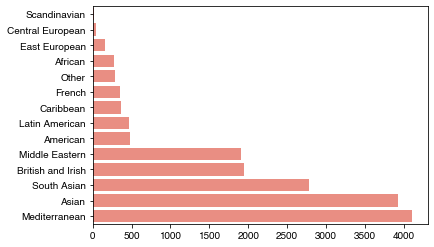

In [164]:
sns.barplot(y=london_totals.keys(), x=london_totals.values, color="salmon", orient="h")

I will combine Central European (42) and Scandinavian (23) with "Other", but will keep the other groupings.

In [165]:
london_cultures['Rest of the world'] = london_cultures[["Central European", "Scandinavian", "Other"]].sum(axis=1)
london_cultures.drop(["Central European", "Scandinavian", "Other"], axis=1, inplace=True)

My goal is to investigate how much cultures mix and interact in a local area. So irrespective of how many venues there may be in any hexagon, I want to normalise the profile by each hexagon's total. But first, let's just what those totals are. 

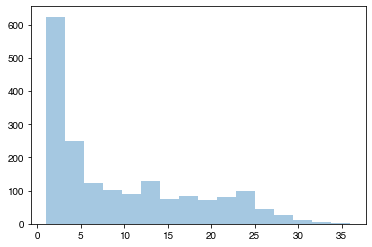

In [169]:
sns.distplot(london_cultures.sum(axis=1), kde=False)

Now, this is very interesting. In over 600 hexagons, there is just one or two venues of interest. I have a suspicion that these are mainly residential areas with their local restaurant and take-away. Let's keep them for now. 

In [174]:
hexagon_totals = london_cultures.sum(axis=1)
london_hex_profiles = london_cultures.div(hexagon_totals, axis=0)
london_hex_profiles.head()

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
hexagon,,,,,,,,,,,,
4,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.0
8,0.0,0.0,0.500000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.500000,0.000000,0.0
9,0.0,0.0,0.333333,0.333333,0.0,0.0,0.0,0.0,0.000000,0.333333,0.000000,0.0
18,0.0,0.0,0.000000,1.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0
22,0.0,0.0,0.333333,0.000000,0.0,0.0,0.0,0.0,0.333333,0.000000,0.333333,0.0


Now let's cluster away. I will use K-means clustering, as I am interested in how similar my hexagons are, and K-means is a simple ML technique, which is going to give that answer. The only problem, of course, is that I don't know how many groupings to expect. 

In [175]:
X = london_hex_profiles.values

In [176]:
from sklearn.cluster import KMeans

In [261]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score 

First, a trial with 5 clusters

In [230]:
k_means = KMeans(init = "k-means++", n_clusters = 5, n_init = 12)
k_means.fit(X)
labels5 = k_means.labels_

Let's see it on the map 

In [318]:
london_labeled_hexagons = pd.DataFrame(
    {
        "Total venues": london_cultures.sum(axis=1),
        "Cluster ID": labels5
    }
)

In [319]:
london_labeled_hexagons

,Total venues,Cluster ID
hexagon,,
4,1,4
8,2,3
9,3,3
18,1,2
22,3,3
...,...,...
2406,1,1
2407,4,1
2414,2,2


In [320]:
london_labeled_hexagons = london_labeled_hexagons.merge(london_df, left_index=True, right_index=True)
london_labeled_hexagons.head()

,Total venues,Cluster ID,Borough,Latitude,Longitude
4,1,4,Bromley,51.293501,0.057077
8,2,3,Croydon,51.300242,-0.123759
9,3,3,Croydon,51.300242,-0.111288
18,1,2,Croydon,51.306983,-0.117524
22,3,3,Bromley,51.306983,0.032134


In [321]:
london_labeled_map = folium.Map(
    location=[centre_lat_lon, centre_lng_lon], 
    zoom_start=10, 
    tiles='cartodbpositron'
)
style_function = lambda x: {
    'fillColor': "#cccccc",
    'color': "#aaaaaa"
}
label_colors = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00']
for borough in london_boroughs_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson',
        style_function=style_function
    ).add_to(london_labeled_map)

for lat, lng, cluster_id, total in zip(london_labeled_hexagons["Latitude"], 
                                          london_labeled_hexagons["Longitude"],
                                          london_labeled_hexagons["Cluster ID"],
                                          london_labeled_hexagons["Total venues"]
                                         ):
    label = f"Cluster {cluster_id}: {total} Venues"
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=label_colors[cluster_id],
        fill=True,
        fill_color=label_colors[cluster_id],
        fill_opacity=1,
        parse_html=False
    ).add_to(london_labeled_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Greater London painted by culinary culture</b></h3>'
    
london_labeled_map.get_root().html.add_child(folium.Element(title_html))

london_labeled_map


In [236]:
london_labeled_profiles = london_hex_profiles

In [237]:
london_labeled_profiles["Cluster ID"] = labels5

In [238]:
london_labeled_profiles.head()

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world,Cluster ID
hexagon,,,,,,,,,,,,,
4,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.0,4
8,0.0,0.0,0.500000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.500000,0.000000,0.0,3
9,0.0,0.0,0.333333,0.333333,0.0,0.0,0.0,0.0,0.000000,0.333333,0.000000,0.0,3
18,0.0,0.0,0.000000,1.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,2
22,0.0,0.0,0.333333,0.000000,0.0,0.0,0.0,0.0,0.333333,0.000000,0.333333,0.0,3


In [239]:
london_labeled_profiles.groupby("Cluster ID").mean() * 100

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
Cluster ID,,,,,,,,,,,,
0,0.565959,1.627010,81.012957,7.871443,0.413700,0.583977,0.096525,0.122513,3.156118,0.536809,3.506779,0.506211
1,0.534931,2.384179,15.430167,9.287784,1.281265,0.499245,2.223741,1.839707,49.509631,5.407552,9.923025,1.678773
2,0.158228,1.582278,4.309825,81.497890,0.527426,0.949367,0.866486,0.316456,1.825648,3.454641,3.524714,0.987040
3,1.925582,4.564045,23.802017,10.919143,2.808404,1.100654,1.792334,2.280147,15.514350,15.512451,17.094884,2.685988
4,0.896552,1.620025,6.591933,6.915331,0.767869,0.734454,0.540936,0.067270,3.643130,4.357509,73.549201,0.315789


In [240]:
london_labeled_profiles.groupby("Cluster ID").std() * 100

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
Cluster ID,,,,,,,,,,,,
0,3.836709,8.249310,21.438210,16.767633,2.122387,4.473389,1.174278,1.214014,8.341906,2.732094,8.825937,4.312597
1,2.356329,6.152322,13.820524,11.569902,4.569391,2.918624,6.267342,4.036313,20.066732,8.197995,12.482723,4.747538
2,1.988893,8.314836,10.188377,22.628541,4.766630,6.845704,5.605850,3.977786,6.322231,11.110821,9.173393,6.157657
3,6.411492,14.294434,14.598206,10.889835,8.827633,4.881604,7.244766,6.757595,11.215649,20.128489,14.214914,10.699916
4,4.960754,6.600180,10.911002,14.464063,4.474243,4.535059,3.635813,0.546321,7.659416,10.815991,21.516560,2.400482


In [241]:
london_labeled_profiles.groupby("Cluster ID").count()

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
Cluster ID,,,,,,,,,,,,
0,148,148,148,148,148,148,148,148,148,148,148,148
1,446,446,446,446,446,446,446,446,446,446,446,446
2,158,158,158,158,158,158,158,158,158,158,158,158
3,873,873,873,873,873,873,873,873,873,873,873,873
4,190,190,190,190,190,190,190,190,190,190,190,190


One can start discerning some patterns already. Cluster 3 (purple in the map above) is the largest and the most mixed with nearly each culture represented to a degree. Cluster 1 is dominated by Mediterranean cuisine (in my definition), but with a good showing of Asian and South Asian. Cluster 2 is decidedly British and Irish (mainly all the pubs, I guess). Cluster 4 is clearly South Asian and cluster 0 is Asian.

Let's see if more clusters will give a clearer picture?

In [485]:
min_clusters = 2
max_clusters = 25
labels = {}
for k in range(min_clusters, max_clusters):
    k_means = KMeans(init = "k-means++", n_clusters = k, n_init = 12)
    k_means.fit(X)
    labels[k] = k_means.labels_  

In [486]:
variability = []
silhouette = []
calinski_harabasz = []
davies_bouldin = [] 
for k in range(min_clusters, max_clusters):
    london_hex_profiles["Cluster ID"] = labels[k]
    groups = london_hex_profiles.groupby("Cluster ID")
    # means_df = groups.mean() * 100
    stds_df = groups.std().T.mean()
    counts = groups.count().T.max()
    variability.append((stds_df * counts).mean())
    silhouette.append(silhouette_score(X, labels[k]))
    calinski_harabasz.append(calinski_harabasz_score(X, labels[k])) 
    davies_bouldin.append(davies_bouldin_score(X, labels[k])) 

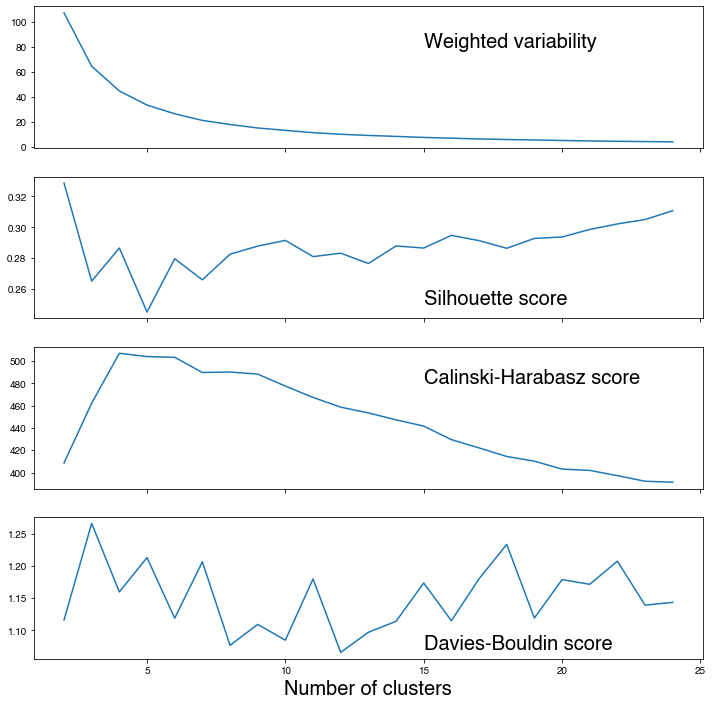

In [488]:
fig, ax = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=[12,12])

sns.lineplot(x=range(min_clusters, max_clusters), y=variability, ax=ax[0])
ax[0].text(15, 80, "Weighted variability", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=silhouette, ax=ax[1])
ax[1].text(15, 0.25, "Silhouette score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=calinski_harabasz, ax=ax[2])
ax[2].text(15, 480, "Calinski-Harabasz score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=davies_bouldin, ax=ax[3])
ax[3].text(15, 1.07, "Davies-Bouldin score", fontsize=20)
ax[3].set_xlabel("Number of clusters", fontsize=20)

#ax[0].set_title("Deciding on correct number of clusters", fontsize=20)
plt.show()

Of course, the more clusters I ask for, the less internal variability there will be within each cluster. But with just 12 categories of cuisine, the total number should not be too large.

This is not very conclusive, but the clearest picture is offered by the Calinski-Harabasz score, which maximises the ratio between inter-cluster variability and the intra-cluster variability. It seems to point to 4, 5 or 6 clusters as  optimal.  

Let's redo the clustering but with a higher number of replicas (100 instead of 12) and inspect the results

In [503]:
min_clusters = 4
max_clusters = 6
labels = {}
for k in range(min_clusters, max_clusters+1):
    k_means = KMeans(init = "k-means++", n_clusters = k, n_init = 100)
    k_means.fit(X)
    labels[k] = k_means.labels_  

In [504]:
variability = []
silhouette = []
calinski_harabasz = []
davies_bouldin = [] 
means = {}
counts = {}
for k in range(min_clusters, max_clusters+1):
    london_hex_profiles["Cluster ID"] = labels[k]
    groups = london_hex_profiles.groupby("Cluster ID")
    means[k] = groups.mean() * 100
    #print(means_df)
    stds_df = groups.std().T.mean()
    counts[k] = groups.count().T.max()
    variability.append((stds_df * counts[k]).mean())
    silhouette.append(silhouette_score(X, labels[k]))
    calinski_harabasz.append(calinski_harabasz_score(X, labels[k])) 
    davies_bouldin.append(davies_bouldin_score(X, labels[k])) 

In [281]:
calinski_harabasz, variability, silhouette, davies_bouldin

([507.0189942802372, 503.8669022825315, 503.380945474792],
 [44.769086374237126, 33.516539104785835, 26.48820305442409],
 [0.28690687189608216, 0.24229078564859702, 0.27961582398004375],
 [1.1560908873227116, 1.2167152516907893, 1.1187471446430441])

Same story, really. 

In [273]:
means[4]

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
Cluster ID,,,,,,,,,,,,
0,1.578871,4.203734,18.720572,10.410419,2.519747,0.911032,2.169327,2.468952,30.419074,12.674359,11.256865,2.667048
1,0.160256,1.602564,3.884310,81.877055,0.534188,0.961538,0.877595,0.320513,1.466904,3.646861,3.668522,0.999695
2,0.737996,1.528717,14.115055,9.080921,0.851207,0.783051,0.686348,0.174757,6.557215,5.184671,59.762914,0.537149
3,0.845580,2.047210,69.161115,7.890615,0.775251,0.649343,0.261816,0.300104,5.313925,5.177668,7.064455,0.512918


In [277]:
means[5]

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
Cluster ID,,,,,,,,,,,,
0,0.819450,1.543247,12.442147,7.117003,0.588287,0.848902,0.499552,0.109141,3.862787,4.743013,67.019404,0.407066
1,0.506656,2.330229,13.411209,8.388389,0.982420,0.383034,2.221674,1.589034,52.797060,5.222481,10.738848,1.428964
2,1.894064,4.631648,24.490583,12.497031,2.871776,1.092063,1.852731,2.354746,17.065697,14.661163,13.825474,2.763024
3,0.172414,1.724138,2.684729,84.371100,0.574713,1.034483,0.747126,0.344828,1.258621,3.247126,2.863711,0.977011
4,0.035714,0.000000,90.510705,1.648980,0.208333,0.280612,0.127551,0.127551,2.858981,0.498866,3.548894,0.153812


In [510]:
means[6].round(0)

,African,American,Asian,British and Irish,Caribbean,East European,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
Cluster ID,,,,,,,,,,,,
0,1.0,2.0,12.0,5.0,2.0,1.0,0.0,0.0,7.0,61.0,7.0,1.0
1,2.0,5.0,25.0,14.0,3.0,1.0,2.0,2.0,20.0,9.0,15.0,3.0
2,1.0,1.0,12.0,6.0,1.0,1.0,1.0,0.0,3.0,3.0,70.0,0.0
3,0.0,2.0,3.0,87.0,1.0,1.0,1.0,0.0,0.0,1.0,2.0,1.0
4,0.0,2.0,12.0,7.0,1.0,0.0,2.0,1.0,59.0,5.0,9.0,1.0
5,0.0,0.0,91.0,2.0,0.0,0.0,0.0,0.0,2.0,1.0,3.0,0.0


In [511]:
counts[6]

Cluster ID
0    105
1    978
2    218
3    133
4    271
5    110
dtype: int64

In conclusion: London's culinary landscape can be described in terms of four clusters: *British and Irish*, *Asian*, *South Asian*, and *Mixed*, which is the largest of all. From the *Mixed* cluster one could possibly detach two sub-clusters: a *Mediterranean* and a *Middle Eastern* one. 

Let's plot the map again for 6 clusters.

In [508]:
london_labeled_hexagons = pd.DataFrame(
    {
        "Total venues": london_cultures.sum(axis=1),
        "Cluster ID": labels[6]
    }
)
london_labeled_hexagons = london_labeled_hexagons.merge(london_df, left_index=True, right_index=True)


In [292]:
from colour import Color 

In [555]:
label_colors = {
    "Mixed":'#e31a1c',
    "Mediterranean":'#a6cee3',
    "Asian":'#1f78b4',
    "South Asian":'#6a3d9a',
    "Middle Eastern":'#33a02c',
    "British and Irish":'#fb9a99',
    "French": '#fdbf6f',
    "Scandinavian": '#ff7f00',
    "East European": '#cab2d6',
    "Rest of the world": '#ffff99',
    "American": '#b15928',
    "Latin American": '#b2df8a'
}
# ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99', '#e31a1c',
# '#fdbf6f','#ff7f00','#cab2d6','#6a3d9a','#ffff99','#b15928']

In [553]:
london_labeled_map = folium.Map(
    location=[centre_lat_lon, centre_lng_lon], 
    zoom_start=10, 
    tiles='cartodbpositron'
)
style_function = lambda x: {
    'fillColor': "#cccccc",
    'color': "#aaaaaa"
}
#label_colors = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00','#ffff33']
# the order below depends on a particular run.
cluster_labels = [
    "Middle Eastern", 
    "Mixed", 
    "South Asian", 
    "British and Irish", 
    "Mediterranean",
    "Asian"
]
for borough in london_boroughs_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson',
        style_function=style_function
    ).add_to(london_labeled_map)

for lat, lng, cluster_id, total in zip(london_labeled_hexagons["Latitude"], 
                                          london_labeled_hexagons["Longitude"],
                                          london_labeled_hexagons["Cluster ID"],
                                          london_labeled_hexagons["Total venues"]
                                         ):
    label = f"{cluster_labels[cluster_id]} cluster: {total} Venues"
    hex_color = Color(label_colors[cluster_labels[cluster_id]])
    if total<10:
        hex_color.saturation *= 0.1*total

    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color=hex_color.hex_l,
        fill=True,
        fill_color=hex_color.hex_l,
        fill_opacity=1,
        parse_html=False
    ).add_to(london_labeled_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Greater London painted by culinary culture</b></h3>'
    
london_labeled_map.get_root().html.add_child(folium.Element(title_html))

london_labeled_map


The colour of each hexagon is attenuated by the number of venues if it falls below 10. This gives a neat picture of 
a thoroughly mixed city! The largest cluster (red) is the *Mixed* one. Interestingly, it has a few pockets of green, which stands for *Middle Eastern* (Kebab shops?), and of pale blue, which stands for *Mediterranean* (Pizza?). The West parts of London are less venue-rich, but there the *South Asian* venues are clearly visible (purple), if not quite dominating, and there is a pocket of deep blue in the North West, which stand for Asian. Conspicuously, "British and Irish" is almost invisble. There are over 100 hexagons classified as "British and Irish", but they have few venues, so are faded towards grey.
### End of 3A 
------

### 3B: Stockholm

Now, let's repeat the process for Stockholm. 
Unfortunately, Foursquare API has a rate limit of no more than 5000 calls per hour to the venues/* endpoints, and I have over 9000 hexagons for the Greater Stockholm. I'll split the dataframe into three sections and will then merge them. 

In [299]:
greater_stockholm_df.loc[:4300,:].shape

(4301, 3)

In [300]:
stockholm_venues_df_1 = get_all_venues(greater_stockholm_df.loc[:4300,:])

Processing hexagon nr 0
Processing hexagon nr 100
Processing hexagon nr 200
Processing hexagon nr 300
Processing hexagon nr 400
Processing hexagon nr 500
Processing hexagon nr 600
Processing hexagon nr 700
Processing hexagon nr 800
Processing hexagon nr 900
Processing hexagon nr 1000
Processing hexagon nr 1100
Processing hexagon nr 1200
Processing hexagon nr 1300
Processing hexagon nr 1400
Processing hexagon nr 1500
Processing hexagon nr 1600
Processing hexagon nr 1700
Processing hexagon nr 1800
Processing hexagon nr 1900
Processing hexagon nr 2000
Processing hexagon nr 2100
Processing hexagon nr 2200
Processing hexagon nr 2300
Processing hexagon nr 2400
Processing hexagon nr 2500
Processing hexagon nr 2600
Processing hexagon nr 2700
Processing hexagon nr 2800
Processing hexagon nr 2900
Processing hexagon nr 3000
Processing hexagon nr 3100
Processing hexagon nr 3200
Processing hexagon nr 3300
Processing hexagon nr 3400
Processing hexagon nr 3500
Processing hexagon nr 3600
Processing he

In [303]:
stockholm_venues_df_1.tail()

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
2,4282.0,59.471199,17.916292,Goldrain wok&thai,Thai Restaurant,Asian,0.0
3,4282.0,59.471287,17.916125,S G sushi & thai,Asian Restaurant,Asian,0.0
0,4289.0,59.465492,18.043881,V.T.S Pizza & Kebab & Grill,Kebab Restaurant,Middle Eastern,0.0
1,4289.0,59.465207,18.042918,Valla Thai,Asian Restaurant,Asian,0.0
0,4295.0,59.463950,18.133332,Mätt På Thai Sätt,Thai Restaurant,Asian,0.0


In [308]:
stockholm_venues_df_2 = get_all_venues(greater_stockholm_df.loc[4300:8600,:])

Processing hexagon nr 4300
Processing hexagon nr 4400
Processing hexagon nr 4500
Processing hexagon nr 4600
Processing hexagon nr 4700
Processing hexagon nr 4800
Processing hexagon nr 4900
Processing hexagon nr 5000
Processing hexagon nr 5100
Processing hexagon nr 5200
Processing hexagon nr 5300
Processing hexagon nr 5400
Processing hexagon nr 5500
Processing hexagon nr 5600
Processing hexagon nr 5700
Processing hexagon nr 5800
Processing hexagon nr 5900
Processing hexagon nr 6000
Processing hexagon nr 6100
Processing hexagon nr 6200
Processing hexagon nr 6300
Processing hexagon nr 6400
Processing hexagon nr 6500
Processing hexagon nr 6600
Processing hexagon nr 6700
Processing hexagon nr 6800
Processing hexagon nr 6900
Processing hexagon nr 7000
Processing hexagon nr 7100
Processing hexagon nr 7200
Processing hexagon nr 7300
Processing hexagon nr 7400
Processing hexagon nr 7500
Processing hexagon nr 7600
Processing hexagon nr 7700
Processing hexagon nr 7800
Processing hexagon nr 7900
P

In [364]:
stockholm_venues_df_3 = get_all_venues(greater_stockholm_df.loc[8600:,:])

Processing hexagon nr 8600
Processing hexagon nr 8700
Processing hexagon nr 8800
Processing hexagon nr 8900
Processing hexagon nr 9000
Processing hexagon nr 9100
Processing hexagon nr 9200
Processing hexagon nr 9300
Processing hexagon nr 9400


In [365]:
stockholm_venues_df_3.tail()

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
0,9151.0,60.060680,18.797512,En Åker,BBQ Joint,American,0.0
0,9243.0,60.092678,18.795867,Achilles Taverna,Greek Restaurant,Mediterranean,0.0
0,9265.0,60.092678,18.795867,Achilles Taverna,Greek Restaurant,Mediterranean,0.0
0,9353.0,60.127926,18.648689,Russian Kitchen @HDC,Russian Restaurant,East European,0.0
0,9354.0,60.127926,18.648689,Russian Kitchen @HDC,Russian Restaurant,East European,0.0


Let's combine the resulting DataFrames and clean up a bit.

In [314]:
stockholm_venues_df = stockholm_venues_df_1.append(stockholm_venues_df_2).append(stockholm_venues_df_3)

In [315]:
stockholm_venues_df.shape

(3751, 7)

In [322]:
stockholm_venues_df["hexagon"] = [int(x) for x in stockholm_venues_df["hexagon"]]
stockholm_venues_df["exceeds_limit"] = [int(x) for x in stockholm_venues_df["exceeds_limit"]]
stockholm_venues_df.head()

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
0,94,58.910826,17.945155,Restaurang flamenco,Spanish Restaurant,Mediterranean,0
1,94,58.913074,17.948343,Nynäshamn Sushi,Japanese Restaurant,Asian,0
2,94,58.909680,17.948414,China Restaurant,Chinese Restaurant,Asian,0
3,94,58.914143,17.946264,Srimoti,Indian Restaurant,South Asian,0
4,94,58.914274,17.946010,Rim Nam,Thai Restaurant,Asian,0


In [323]:
limit_reached = (stockholm_venues_df[['hexagon','exceeds_limit']].groupby('hexagon').sum()['exceeds_limit']>0).sum()
print(f"{limit_reached} hexagons likely to have exceeded the limit of 50 venues")

34 hexagons likely to have exceeded the limit of 50 venues


Probably inner city has more than 50 venues for a ~0.8 square km... But there are limits to what we can do.

Let's define a utility function, instead if copying everything from the section on London.

In [325]:
def get_cultures(venues_df):
    cultures = pd.get_dummies(venues_df[["cultural_category"]])
    cultures.columns = [x.split("_")[-1] for x in cultures.columns]
    cultures["hexagon"] = venues_df["hexagon"]
    return cultures.groupby("hexagon").sum()

In [326]:
stockholm_cultures = get_cultures(stockholm_venues_df)
stockholm_cultures.head()

,African,American,Asian,British and Irish,Caribbean,Central European,East European,French,Latin American,Mediterranean,Middle Eastern,Other,Scandinavian,South Asian
hexagon,,,,,,,,,,,,,,
94,0,1,6,0,0,0,0,0,0,4,0,0,0,1
107,0,0,0,0,0,0,0,0,0,1,0,0,0,0
108,0,0,3,0,0,0,0,0,0,3,0,0,0,1
223,0,1,0,0,0,0,0,0,0,1,0,0,1,0
247,0,1,0,0,0,0,0,0,0,1,0,0,1,0


In [330]:
stockholm_totals = stockholm_cultures.sum().sort_values()

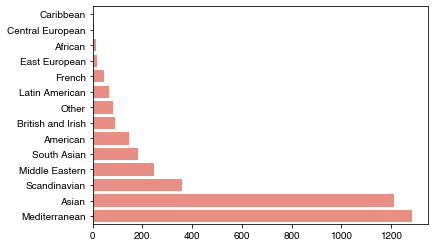

In [331]:
sns.barplot(y=stockholm_totals.keys(), x=stockholm_totals.values, color="salmon", orient="h")

In [332]:
stockholm_totals

Caribbean               3
Central European        5
African                13
East European          18
French                 44
Latin American         66
Other                  81
British and Irish      88
American              146
South Asian           184
Middle Eastern        247
Scandinavian          360
Asian                1213
Mediterranean        1283
dtype: int64

Like in London, the most popular kinds of cuisines include *Mediterranean* and *Asian*. *Scandinavian* comes a distant third. To simplify further analysis, I will combine everything that has fewer than 100 venues into "Rest of the world"

In [334]:
categories_to_sum = ["Caribbean", 
                     "Central European", 
                     "African", 
                     "East European", 
                     "French", 
                     "Latin American", 
                     "British and Irish",
                     "Other"]
stockholm_cultures['Rest of the world'] = stockholm_cultures[categories_to_sum].sum(axis=1)
stockholm_cultures.drop(categories_to_sum, axis=1, inplace=True)
stockholm_cultures.head()

,American,Asian,Mediterranean,Middle Eastern,Scandinavian,South Asian,Rest of the world
hexagon,,,,,,,
94,1,6,4,0,0,1,0
107,0,0,1,0,0,0,0
108,0,3,3,0,0,1,0
223,1,0,1,0,1,0,0
247,1,0,1,0,1,0,0


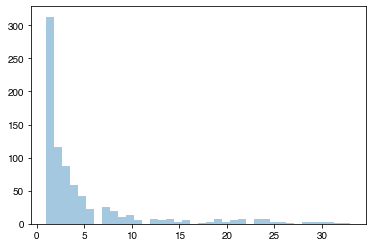

In [335]:
sns.distplot(stockholm_cultures.sum(axis=1), kde=False)

Greater Stockholm occupies a larger territory than London, but with significantly fewer people, so it is no surprize that majority of hexagons have just 1 venue (of those that returned any results, that is).

Let's repeat the clustering exercise

In [532]:
hexagon_totals = stockholm_cultures.sum(axis=1)
stockholm_hex_profiles = stockholm_cultures.div(hexagon_totals, axis=0)
stockholm_hex_profiles.head()

,American,Asian,Mediterranean,Middle Eastern,Scandinavian,South Asian,Rest of the world
hexagon,,,,,,,
94,0.083333,0.500000,0.333333,0.0,0.000000,0.083333,0.0
107,0.000000,0.000000,1.000000,0.0,0.000000,0.000000,0.0
108,0.000000,0.428571,0.428571,0.0,0.000000,0.142857,0.0
223,0.333333,0.000000,0.333333,0.0,0.333333,0.000000,0.0
247,0.333333,0.000000,0.333333,0.0,0.333333,0.000000,0.0


In [533]:
X_shlm = stockholm_hex_profiles.values

In [534]:
min_clusters = 2
max_clusters = 25
labels = {}
for k in range(min_clusters, max_clusters):
    k_means = KMeans(init = "k-means++", n_clusters = k, n_init = 12)
    k_means.fit(X_shlm)
    labels[k] = k_means.labels_  

In [535]:
variability = []
silhouette = []
calinski_harabasz = []
davies_bouldin = [] 
means = {}
counts = {}
for k in range(min_clusters, max_clusters):
    stockholm_hex_profiles["Cluster ID"] = labels[k]
    groups = stockholm_hex_profiles.groupby("Cluster ID")
    means[k] = groups.mean() * 100
    #print(means_df)
    stds_df = groups.std().T.mean()
    counts[k] = groups.count().T.max()
    variability.append((stds_df * counts[k]).mean())
    silhouette.append(silhouette_score(X_shlm, labels[k]))
    calinski_harabasz.append(calinski_harabasz_score(X_shlm, labels[k])) 
    davies_bouldin.append(davies_bouldin_score(X_shlm, labels[k])) 

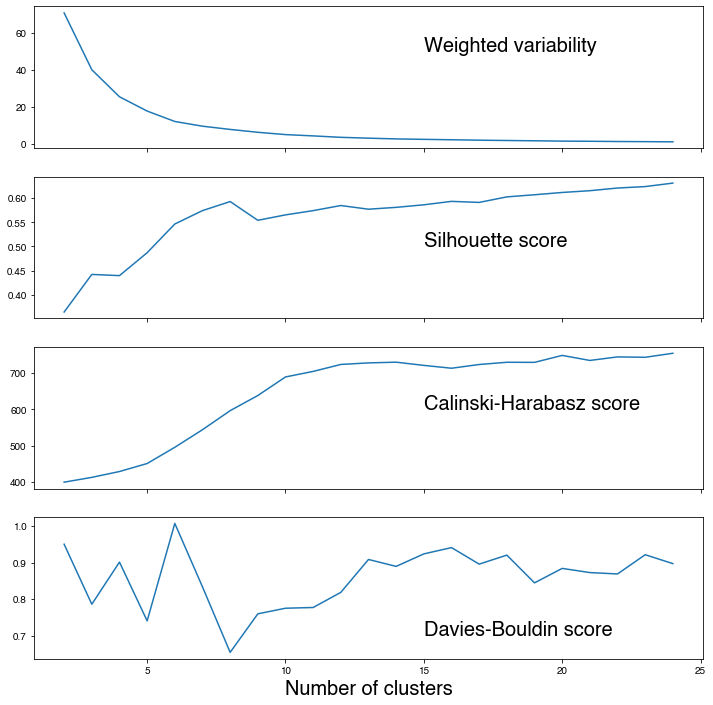

In [536]:
fig, ax = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=[12,12])

sns.lineplot(x=range(min_clusters, max_clusters), y=variability, ax=ax[0])
ax[0].text(15, 50, "Weighted variability", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=silhouette, ax=ax[1])
ax[1].text(15, 0.5, "Silhouette score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=calinski_harabasz, ax=ax[2])
ax[2].text(15, 600, "Calinski-Harabasz score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=davies_bouldin, ax=ax[3])
ax[3].text(15, 0.7, "Davies-Bouldin score", fontsize=20)
ax[3].set_xlabel("Number of clusters", fontsize=20)

#ax[0].set_title("Deciding on correct number of clusters", fontsize=20)
plt.show()

Unlike in the case of London, there is no clear best K by any of the metrics. Calinski-Harabasz score I used for London exhibits a very different pattern, but perhaps 12 clusters based on that score is reasonable. On the other hand, Silhouette score points to 8 clusters. Let's have a closer look at both to see if there is meaningful story.

In [537]:
stockholm_labeled_hexagons_8 = pd.DataFrame(
    {
        "Total venues": stockholm_cultures.sum(axis=1),
        "Cluster ID": labels[8]
    }
)
stockholm_labeled_hexagons_8 = stockholm_labeled_hexagons_8.merge(
    greater_stockholm_df, 
    left_index=True, 
    right_index=True
)


In [540]:
means[8].T.round(0)

Cluster ID,0,1,2,3,4,5,6,7
American,0.0,2.0,2.0,3.0,100.0,0.0,0.0,0.0
Asian,0.0,6.0,0.0,38.0,0.0,12.0,94.0,5.0
Mediterranean,97.0,14.0,2.0,38.0,0.0,9.0,2.0,19.0
Middle Eastern,1.0,3.0,0.0,4.0,0.0,0.0,1.0,68.0
Scandinavian,1.0,5.0,95.0,8.0,0.0,0.0,1.0,3.0
South Asian,0.0,1.0,0.0,4.0,0.0,79.0,1.0,4.0
Rest of the world,0.0,70.0,1.0,5.0,0.0,0.0,1.0,1.0


In [542]:
counts[8].values

array([206,  33,  61, 343,  22,  17,  80,  38])

With 8 clusters, there seems a pattern emerging. The largest cluster (3) is the most mixed, although not to the extend of London. All the other clusters have a dominant cuisine, with cluster 5 being *Scandinavian* and 0 being *Rest of the world*. 


In [361]:
means[12]

,American,Asian,Mediterranean,Middle Eastern,Scandinavian,South Asian,Rest of the world
Cluster ID,,,,,,,
0,0.128866,0.211708,99.014482,0.103093,0.103093,0.064433,0.374325
1,3.315625,53.652078,22.687334,4.538863,4.946566,6.968249,3.891285
2,0.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000
3,2.539683,9.685426,46.807119,31.447330,2.721501,5.925926,0.873016
4,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,100.000000
6,1.399755,38.997454,51.758060,1.060292,2.802018,2.763771,1.218650
7,0.000000,99.621212,0.000000,0.000000,0.189394,0.189394,0.000000
8,4.824266,25.891216,24.639259,7.905478,6.693437,5.549473,24.496872


In [362]:
counts[12]

Cluster ID
0     194
1     114
2      54
3      45
4      22
5      15
6     139
7      66
8      72
9      10
10     19
11     50
dtype: int64

Similar picture for 12 clusters, really, except the largest cluster is not *mixed*, but *Mediterranean*, and there is less mixing within clusters (adding more clusters would of course lead to this). Probably such fragmentation is caused by the large number of hexagons with just 1 venue. I think it is time to plot it all on the map, to see if culinary clusters translate into geographic proximity.

In [549]:
stockholm_labeled_map = folium.Map(
    location=[centre_lat_shlm, centre_lng_shlm], 
    zoom_start=9, 
    tiles='cartodbpositron'
)
style_function = lambda x: {
    'fillColor': "#cccccc",
    'color': "#aaaaaa"
}
#label_colors = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00','#ffff33','#a65628','#f781bf']
#label_colors = ['#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02','#a6761d','#666666']
cluster_labels = [
    "Mediterranean", 
    "Rest of the world", 
    "Scandinavian", 
    "Mixed", 
    "American", 
    "South Asian",
    "Asian", 
    "Middle Eastern", 
]

for borough in stockholm_kommuner["features"]:
    folium.GeoJson(
        borough,
        name='geojson',
        style_function=style_function
    ).add_to(stockholm_labeled_map)

for lat, lng, cluster_id, total in zip(stockholm_labeled_hexagons_8["Latitude"], 
                                       stockholm_labeled_hexagons_8["Longitude"],
                                       stockholm_labeled_hexagons_8["Cluster ID"],
                                       stockholm_labeled_hexagons_8["Total venues"]):
    label = f"{cluster_labels[cluster_id]} cluster: {total} Venues"
    hex_color = Color(label_colors[cluster_labels[cluster_id]])
    #if total<5:
    #    hex_color.saturation *= 0.2*total

    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color=hex_color.hex_l,
        fill=True,
        fill_color=hex_color.hex_l,
        fill_opacity=1,
        parse_html=False
    ).add_to(stockholm_labeled_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Greater Stockholm painted by culinary culture</b></h3>'
    
stockholm_labeled_map.get_root().html.add_child(folium.Element(title_html))

stockholm_labeled_map


That's not very dense at all, outside the core Stockholm city. There are fewer people over larger territory. Fewer tourists too, so fewer venues to look into. Yet, the main cluster (red) is the *Mixed* one, albeit dominated by Asian and Mediterranean cuisines. The very core of Stockholm (round the palace) also sports some of the *Rest of the world* (yellow), which really just adds to the mix. Interestingly, there are well-separated pockets of Scandinavian cuisine (orange), mainly in the outer suburbs, a few pockets of *Middle Eastern* cuisine (green), *South Asian* (purple) and *Asian* (deep blue). The second largest cluster is *Mediterranean* (pale blue), more or less evenly spread. In my definition, this includes all pizzerias, so this may explain its popularity and spread. There is little point investigating 12 clusters. Afetr all - there are only 7 features I fed into the clustering algorithm, and already each of them dominates one of the clusters. Further subdivisions will lead to different flavors of the "mixed" clusters, and more pure mono-cultural ones, but won't alter the overall picture (see above for 12 clusters). 
All in all, a mixed city, but less so than London.

### End of 3B
-----

### Part 3C: Paris
Let's repeat the whole procedure for Paris

In [375]:
grand_paris_df.shape

(1261, 3)

In [376]:
paris_venues_df = get_all_venues(grand_paris_df)

Processing hexagon nr 0
Processing hexagon nr 100
Processing hexagon nr 200
Processing hexagon nr 300
Processing hexagon nr 400
Processing hexagon nr 500
Processing hexagon nr 600
Processing hexagon nr 700
Processing hexagon nr 800
Processing hexagon nr 900
Processing hexagon nr 1000
Processing hexagon nr 1100
Processing hexagon nr 1200


In [377]:
paris_venues_df.shape

(10930, 7)

In [378]:
paris_venues_df["hexagon"] = [int(x) for x in paris_venues_df["hexagon"]]
paris_venues_df["exceeds_limit"] = [int(x) for x in paris_venues_df["exceeds_limit"]]
paris_venues_df.head()

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
0,0,48.653457,2.356916,Salam Bombay,Indian Restaurant,South Asian,0
0,3,48.668452,2.381359,Sagarmatha,Indian Restaurant,South Asian,0
0,4,48.675334,2.351382,Speed Rabbit,Pizza Place,Mediterranean,0
1,4,48.676090,2.351319,Restaurant Nemrud,Greek Restaurant,Mediterranean,0
2,4,48.676815,2.350135,Sud Agadir,Moroccan Restaurant,Mediterranean,0


In [380]:
limit_reached = (paris_venues_df[['hexagon','exceeds_limit']].groupby('hexagon').sum()['exceeds_limit']>0).sum()
print(f"{limit_reached} hexagons likely to have exceeded the limit of 50 venues")

107 hexagons likely to have exceeded the limit of 50 venues


In [382]:
paris_cultures = get_cultures(paris_venues_df)
paris_totals = paris_cultures.sum().sort_values()

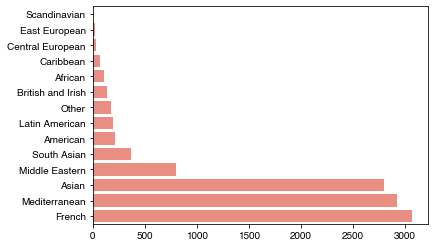

In [383]:
sns.barplot(y=paris_totals.keys(), x=paris_totals.values, color="salmon", orient="h")

Now here is a city proud of its own cuisine! French restaurants top the list, closely followed by the usual Mediterranean and Asian, with Middle Eastern and South Asian a distant fourth and fifth. Let's again fold into rest of the world each cultural category that has fewer than 100 venues to it + Other.

In [384]:
paris_totals

Scandinavian            5
East European          24
Central European       34
Caribbean              72
African               107
British and Irish     142
Other                 176
Latin American        193
American              212
South Asian           369
Middle Eastern        797
Asian                2803
Mediterranean        2929
French               3067
dtype: int64

In [385]:
categories_to_sum = ["Scandinavian", 
                     "Central European", 
                     "East European",
                     "Caribbean",
                     "Other"]
paris_cultures['Rest of the world'] = paris_cultures[categories_to_sum].sum(axis=1)
paris_cultures.drop(categories_to_sum, axis=1, inplace=True)
paris_cultures.head()

,African,American,Asian,British and Irish,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
hexagon,,,,,,,,,,
0,0,0,0,0,0,0,0,0,1,0
3,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,3,0,0,0
5,0,0,1,0,1,2,4,2,0,0
6,0,0,0,0,0,0,1,0,0,0


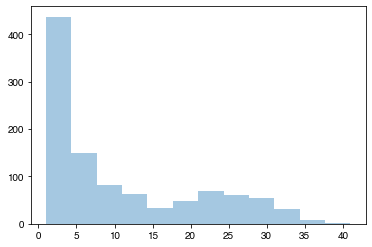

In [386]:
sns.distplot(paris_cultures.sum(axis=1), kde=False)

The usual pattern of few venues per hexagon, seen in London and in even greater extreme in Stockholm. 

In [522]:
hexagon_totals = paris_cultures.sum(axis=1)
paris_hex_profiles = paris_cultures.div(hexagon_totals, axis=0)
paris_hex_profiles.head()

,African,American,Asian,British and Irish,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
hexagon,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
5,0.0,0.0,0.1,0.0,0.1,0.2,0.4,0.2,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [523]:
X_par = paris_hex_profiles.values
min_clusters = 2
max_clusters = 25
labels = {}
for k in range(min_clusters, max_clusters):
    k_means = KMeans(init = "k-means++", n_clusters = k, n_init = 12)
    k_means.fit(X_par)
    labels[k] = k_means.labels_  

In [524]:
variability = []
silhouette = []
calinski_harabasz = []
davies_bouldin = [] 
means = {}
counts = {}
for k in range(min_clusters, max_clusters):
    paris_hex_profiles["Cluster ID"] = labels[k]
    groups = paris_hex_profiles.groupby("Cluster ID")
    means[k] = groups.mean() * 100
    #print(means_df)
    stds_df = groups.std().T.mean()
    counts[k] = groups.count().T.max()
    variability.append((stds_df * counts[k]).mean())
    silhouette.append(silhouette_score(X_par, labels[k]))
    calinski_harabasz.append(calinski_harabasz_score(X_par, labels[k])) 
    davies_bouldin.append(davies_bouldin_score(X_par, labels[k])) 

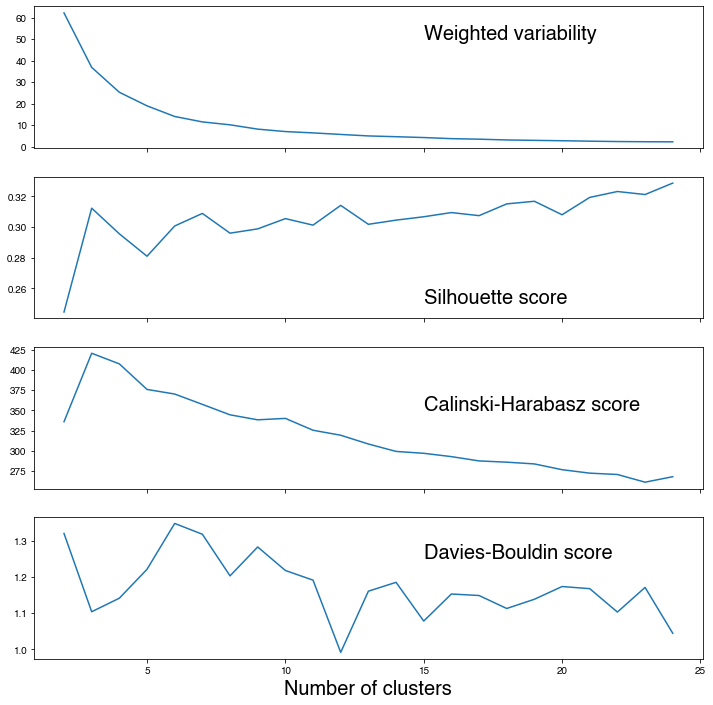

In [525]:
fig, ax = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=[12,12])

sns.lineplot(x=range(min_clusters, max_clusters), y=variability, ax=ax[0])
ax[0].text(15, 50, "Weighted variability", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=silhouette, ax=ax[1])
ax[1].text(15, 0.25, "Silhouette score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=calinski_harabasz, ax=ax[2])
ax[2].text(15, 350, "Calinski-Harabasz score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=davies_bouldin, ax=ax[3])
ax[3].text(15, 1.25, "Davies-Bouldin score", fontsize=20)
ax[3].set_xlabel("Number of clusters", fontsize=20)

#ax[0].set_title("Deciding on correct number of clusters", fontsize=20)
plt.show()

A nice profile from the Calinski-Harabasz score, indicating 3 or 4 clusters as optimal. Let's explore in more detail.

In [393]:
calinski_harabasz

[336.06595379569956,
 420.5089920161328,
 407.4173703232796,
 375.927778465424,
 371.20138156638393,
 357.9310655118589,
 345.62611768567035,
 337.6844437045795,
 335.827724655097,
 327.96712834173,
 319.3951288557881,
 308.87857298525375,
 302.35135189622684,
 293.3259047898875,
 295.75656831490505,
 287.8893058888915,
 284.1919155058997,
 280.14311050472804,
 274.5986240479855,
 270.7586421745901,
 268.43717198953084,
 266.65532529603365,
 264.1377017158086]

In [394]:
means[3]

,African,American,Asian,British and Irish,French,Latin American,Mediterranean,Middle Eastern,South Asian,Rest of the world
Cluster ID,,,,,,,,,,
0,0.394940,1.543393,9.472719,1.513038,61.039653,1.315934,16.206045,4.034750,1.743533,2.735993
1,1.199562,2.841278,35.235984,1.206508,13.488758,2.139733,25.110298,8.909750,5.037130,4.830998
2,0.166667,1.166667,3.129630,0.944444,3.535979,0.313492,83.516402,3.443122,1.483598,2.300000


In [395]:
counts[3]

Cluster ID
0    269
1    618
2    150
dtype: int64

In [526]:
means[4].T.round(0)

Cluster ID,0,1,2,3
African,1.0,0.0,0.0,1.0
American,3.0,0.0,1.0,2.0
Asian,22.0,3.0,8.0,64.0
British and Irish,2.0,1.0,1.0,1.0
French,19.0,2.0,67.0,3.0
Latin American,2.0,0.0,1.0,1.0
Mediterranean,28.0,92.0,14.0,20.0
Middle Eastern,11.0,2.0,3.0,3.0
South Asian,6.0,1.0,2.0,2.0
Rest of the world,6.0,0.0,2.0,3.0


In [527]:
counts[4].T

Cluster ID
0    544
1    119
2    211
3    163
dtype: int64

Again, the largest cluster is the *Mixed* one, and can extract an *Asian* subcluster from it. And then there is *French* and the *Mediterranean* cluster. Let's plot the four clusters on the map.

In [528]:
paris_labeled_hexagons = pd.DataFrame(
    {
        "Total venues": paris_cultures.sum(axis=1),
        "Cluster ID": labels[4]
    }
)
paris_labeled_hexagons = paris_labeled_hexagons.merge(
    grand_paris_df, 
    left_index=True, 
    right_index=True
)


In [550]:
paris_labeled_map = folium.Map(
    location=[centre_lat_par, centre_lng_par], 
    zoom_start=10, 
    tiles='cartodbpositron'
)
style_function = lambda x: {
    'fillColor': "#cccccc",
    'color': "#aaaaaa"
}
#label_colors = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00','#ffff33','#a65628','#f781bf']
#label_colors = ['#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02','#a6761d','#666666']
cluster_labels = [
    "Mixed",
    "Mediterranean", 
    "French",
    "Asian"                   
]

for borough in grand_paris_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson',
        style_function=style_function
    ).add_to(paris_labeled_map)

for lat, lng, cluster_id, total in zip(paris_labeled_hexagons["Latitude"], 
                                       paris_labeled_hexagons["Longitude"],
                                       paris_labeled_hexagons["Cluster ID"],
                                       paris_labeled_hexagons["Total venues"]):
    label = f"{cluster_labels[cluster_id]} cluster: {total} Venues"
    hex_color = Color(label_colors[cluster_labels[cluster_id]])
    if total<10:
        hex_color.saturation *= 0.1*total

    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color=hex_color.hex_l,
        fill=True,
        fill_color=hex_color.hex_l,
        fill_opacity=1,
        parse_html=False
    ).add_to(paris_labeled_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Greater Paris painted by culinary culture</b></h3>'
    
paris_labeled_map.get_root().html.add_child(folium.Element(title_html))

paris_labeled_map


This picture is distinctly different from London and Stockholm. The food in the inner core of Paris is FRENCH (yellow), surrounded by an inner ring of mixed cuisines (red), which is then surrounded by another lower intensity ring of smaller pockets of mainly Mediterranean (pale blue) and Asian (blue), and some French cuisines. 

### End of 3C
--------

### 3D: Vilnius
Let's now repeat the process for the last city - Vilnius.

In [406]:
vilnius_df.shape

(3897, 3)

In [407]:
vilnius_venues_df = get_all_venues(vilnius_df)

Processing hexagon nr 0
Processing hexagon nr 100
Processing hexagon nr 200
Processing hexagon nr 300
Processing hexagon nr 400
Processing hexagon nr 500
Processing hexagon nr 600
Processing hexagon nr 700
Processing hexagon nr 800
Processing hexagon nr 900
Processing hexagon nr 1000
Processing hexagon nr 1100
Processing hexagon nr 1200
Processing hexagon nr 1300
Processing hexagon nr 1400
Processing hexagon nr 1500
Processing hexagon nr 1600
Processing hexagon nr 1700
Processing hexagon nr 1800
Processing hexagon nr 1900
Processing hexagon nr 2000
Processing hexagon nr 2100
Processing hexagon nr 2200
Processing hexagon nr 2300
Processing hexagon nr 2400
Processing hexagon nr 2500
Processing hexagon nr 2600
Processing hexagon nr 2700
Processing hexagon nr 2800
Processing hexagon nr 2900
Processing hexagon nr 3000
Processing hexagon nr 3100
Processing hexagon nr 3200
Processing hexagon nr 3300
Processing hexagon nr 3400
Processing hexagon nr 3500
Processing hexagon nr 3600
Processing he

In [410]:
vilnius_venues_df["hexagon"] = [int(x) for x in vilnius_venues_df["hexagon"]]
vilnius_venues_df["exceeds_limit"] = [int(x) for x in vilnius_venues_df["exceeds_limit"]]
vilnius_venues_df.head()

,hexagon,venue_latitude,venue_longitude,venue_name,foursqaure_category,cultural_category,exceeds_limit
0,563,54.581234,25.060751,Guopsto picerija,Pizza Place,Mediterranean,0
0,573,54.577785,25.198580,Prof Pizza,Pizza Place,Mediterranean,0
0,616,54.581234,25.060751,Guopsto picerija,Pizza Place,Mediterranean,0
0,926,54.623967,25.109926,Senoji Kibininė,Eastern European Restaurant,East European,0
0,936,54.626597,25.248947,kebabu valgymo aikstele,Turkish Restaurant,Middle Eastern,0


In [411]:
vilnius_venues_df.shape

(1036, 7)

In [419]:
limit_reached = (vilnius_venues_df[['hexagon','exceeds_limit']].groupby('hexagon').sum()['exceeds_limit']>0).sum()
print(f"{limit_reached} hexagons likely to have exceeded the limit of 50 venues")

14 hexagons likely to have exceeded the limit of 50 venues


In [420]:
vilnius_cultures = get_cultures(vilnius_venues_df)
vilnius_totals = vilnius_cultures.sum().sort_values()

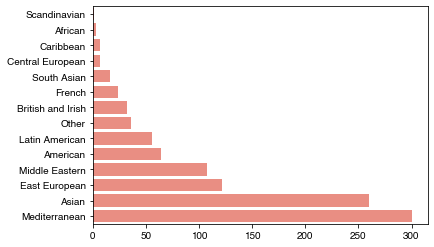

In [421]:
sns.barplot(y=vilnius_totals.keys(), x=vilnius_totals.values, color="salmon", orient="h")

No way, Mediterranean and Asian top the list again. As Vilnius is a much smaller city, I will only lump together  categories with fewer than 30 venues

In [422]:
vilnius_totals

Scandinavian           1
African                3
Caribbean              7
Central European       7
South Asian           16
French                24
British and Irish     32
Other                 36
Latin American        56
American              64
Middle Eastern       108
East European        122
Asian                260
Mediterranean        300
dtype: int64

In [423]:
categories_to_sum = ["Scandinavian", 
                     "Central European", 
                     "African",
                     "Caribbean",
                     "Other",
                     "South Asian",
                     "French"
                    ]
vilnius_cultures['Rest of the world'] = vilnius_cultures[categories_to_sum].sum(axis=1)
vilnius_cultures.drop(categories_to_sum, axis=1, inplace=True)
vilnius_cultures.head()

,American,Asian,British and Irish,East European,Latin American,Mediterranean,Middle Eastern,Rest of the world
hexagon,,,,,,,,
563,0,0,0,0,0,1,0,0
573,0,0,0,0,0,1,0,0
616,0,0,0,0,0,1,0,0
926,0,0,0,1,0,0,0,0
936,0,0,0,0,0,0,1,0


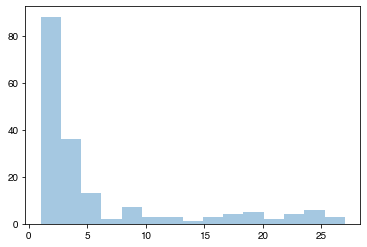

In [424]:
ax = sns.distplot(vilnius_cultures.sum(axis=1), kde=False)

In [563]:
hexagon_totals = vilnius_cultures.sum(axis=1)
vilnius_hex_profiles = vilnius_cultures.div(hexagon_totals, axis=0)
vilnius_hex_profiles.head()

,American,Asian,British and Irish,East European,Latin American,Mediterranean,Middle Eastern,Rest of the world
hexagon,,,,,,,,
563,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
573,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
616,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
926,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
936,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


The pattern of many hexagons with few venues still holds. Let's do the clustering.

In [564]:
X_vno = vilnius_hex_profiles.values
min_clusters = 2
max_clusters = 25
labels = {}
for k in range(min_clusters, max_clusters):
    k_means = KMeans(init = "k-means++", n_clusters = k, n_init = 12)
    k_means.fit(X_vno)
    labels[k] = k_means.labels_  

In [565]:
variability = []
silhouette = []
calinski_harabasz = []
davies_bouldin = [] 
means = {}
counts = {}
for k in range(min_clusters, max_clusters):
    vilnius_hex_profiles["Cluster ID"] = labels[k]
    groups = vilnius_hex_profiles.groupby("Cluster ID")
    means[k] = groups.mean() * 100
    #print(means_df)
    stds_df = groups.std().T.mean()
    counts[k] = groups.count().T.max()
    variability.append((stds_df * counts[k]).mean())
    silhouette.append(silhouette_score(X_vno, labels[k]))
    calinski_harabasz.append(calinski_harabasz_score(X_vno, labels[k])) 
    davies_bouldin.append(davies_bouldin_score(X_vno, labels[k])) 

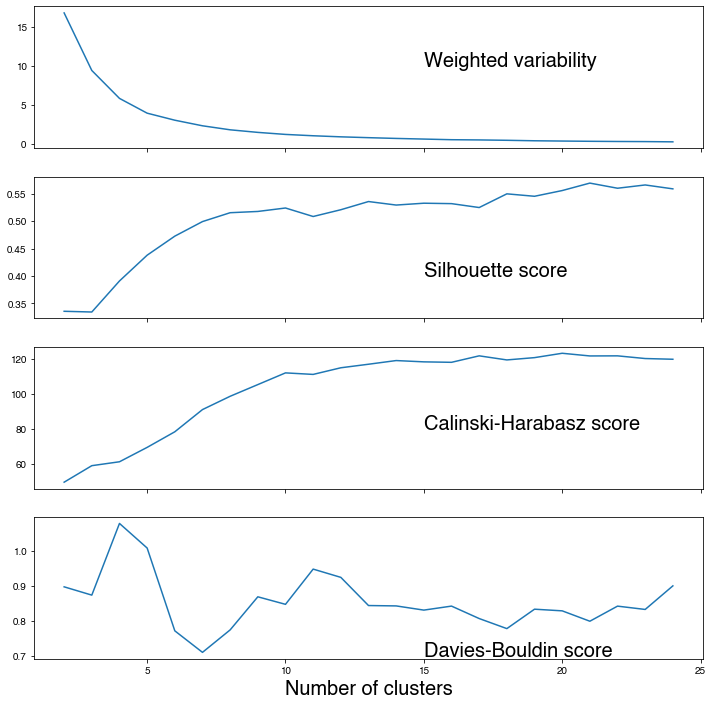

In [566]:
fig, ax = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=[12,12])

sns.lineplot(x=range(min_clusters, max_clusters), y=variability, ax=ax[0])
ax[0].text(15, 10, "Weighted variability", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=silhouette, ax=ax[1])
ax[1].text(15, 0.4, "Silhouette score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=calinski_harabasz, ax=ax[2])
ax[2].text(15, 80, "Calinski-Harabasz score", fontsize=20)

sns.lineplot(x=range(min_clusters, max_clusters), y=davies_bouldin, ax=ax[3])
ax[3].text(15, 0.7, "Davies-Bouldin score", fontsize=20)
ax[3].set_xlabel("Number of clusters", fontsize=20)

#ax[0].set_title("Deciding on correct number of clusters", fontsize=20)
plt.show()

With so few venues, it is not easy to choose a good metric. These graphs look similar to those of Stockholm. But it seems that 8 clusters is reasonable. After all, there are only 8 features (cultural categories). Let's have a closer look

In [567]:
means[8].T.round(0)

Cluster ID,0,1,2,3,4,5,6,7
American,2.0,12.0,75.0,5.0,0.0,0.0,0.0,0.0
Asian,93.0,0.0,0.0,25.0,0.0,1.0,0.0,0.0
British and Irish,0.0,0.0,0.0,4.0,0.0,1.0,4.0,3.0
East European,0.0,10.0,18.0,12.0,0.0,0.0,96.0,3.0
Latin American,0.0,0.0,0.0,5.0,0.0,0.0,0.0,55.0
Mediterranean,0.0,5.0,0.0,33.0,6.0,97.0,0.0,30.0
Middle Eastern,4.0,0.0,7.0,11.0,94.0,1.0,0.0,5.0
Rest of the world,2.0,73.0,0.0,6.0,0.0,0.0,0.0,3.0


In [569]:
counts[8].values

array([ 9, 13, 14, 77, 10, 27, 19, 11])

So even in Vilnius, a city which started to open up to the world in early 1990's, the largest cluster is mixed! Where is it on the map?

In [571]:
vilnius_labeled_hexagons = pd.DataFrame(
    {
        "Total venues": vilnius_cultures.sum(axis=1),
        "Cluster ID": labels[8]
    }
)
vilnius_labeled_hexagons = vilnius_labeled_hexagons.merge(
    vilnius_df, 
    left_index=True, 
    right_index=True
)

In [575]:
vilnius_labeled_map = folium.Map(
    location=[centre_lat_vno, centre_lng_vno], 
    zoom_start=10, 
    tiles='cartodbpositron'
)
style_function = lambda x: {
    'fillColor': "#cccccc",
    'color': "#aaaaaa"
}
#label_colors = ['#e41a1c','#377eb8','#4daf4a','#984ea3','#ff7f00','#ffff33','#a65628','#f781bf']
#label_colors = ['#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02','#a6761d','#666666']
cluster_labels = [
    "Asian",
    "Rest of the world",
    "American",
    "Mixed",
    "Middle Eastern",
    "Mediterranean", 
    "East European", 
    "Latin American",
]

for borough in vilnius_geojson["features"]:
    folium.GeoJson(
        borough,
        name='geojson',
        style_function=style_function
    ).add_to(vilnius_labeled_map)

for lat, lng, cluster_id, total in zip(vilnius_labeled_hexagons["Latitude"], 
                                       vilnius_labeled_hexagons["Longitude"],
                                       vilnius_labeled_hexagons["Cluster ID"],
                                       vilnius_labeled_hexagons["Total venues"]):
    label = f"{cluster_labels[cluster_id]} cluster: {total} Venues"
    #label = f"{cluster_id}"
    hex_color = Color(label_colors[cluster_labels[cluster_id]])
    #if total<5:
    #    hex_color.saturation *= 0.2*total

    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup=label,
        color=hex_color.hex_l,
        fill=True,
        fill_color=hex_color.hex_l,
        fill_opacity=1,
        parse_html=False
    ).add_to(vilnius_labeled_map)  

title_html = f'<h3 align="center" style="font-size:20px"><b>Vilnius painted by culinary culture</b></h3>'
    
vilnius_labeled_map.get_root().html.add_child(folium.Element(title_html))

vilnius_labeled_map


A city with fewer venues (on Foursquare API at least), and clustering is really inconclusive here. Yet, the largest cluster is still *Mixed*. There is no discernible pattern in the distribution of other clusters. And, really, there was no point scraping the venues API for the rural areas. 
### End of 3D

## Part 4: 
### Additional section to produce plots for the report and presentation. 

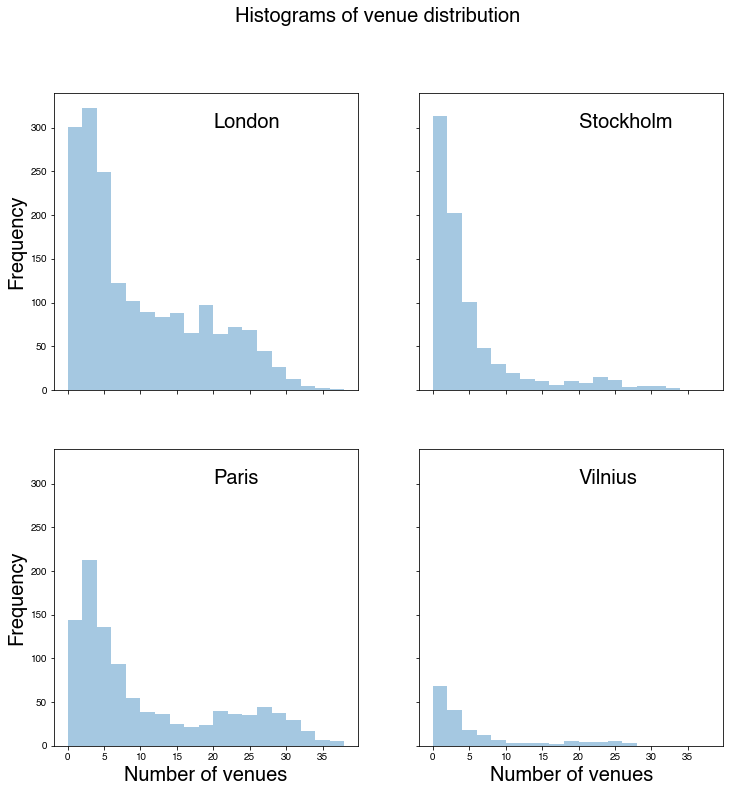

In [470]:
bins = range(0,40,2)
fig, ax = plt.subplots(nrows=2, ncols=2, sharex=True, sharey=True, figsize=[12,12])
sns.distplot(london_cultures.sum(axis=1), kde=False, ax=ax[0,0], bins=bins)
sns.distplot(paris_cultures.sum(axis=1), kde=False, ax=ax[1,0], bins=bins)
sns.distplot(stockholm_cultures.sum(axis=1), kde=False, ax=ax[0,1], bins=bins)
sns.distplot(vilnius_cultures.sum(axis=1), kde=False, ax=ax[1,1], bins=bins)
ax[0,0].text(20,300,"London",fontsize=20)
ax[0,0].set_ylabel("Frequency",fontsize=20)
ax[1,0].text(20,300,"Paris",fontsize=20)
ax[1,0].set_xlabel("Number of venues",fontsize=20)
ax[1,0].set_ylabel("Frequency",fontsize=20)
ax[0,1].text(20,300,"Stockholm",fontsize=20)
ax[1,1].text(20,300,"Vilnius",fontsize=20)
ax[1,1].set_xlabel("Number of venues",fontsize=20)
fig.suptitle("Histograms of venue distribution", fontsize=20)
plt.show()